In [1]:
# Connect google drive to google colab
#from google.colab import drive
#drive.mount('/content/drive')

In [1]:
# Incluya aquí todas las librería que utilice para el desarrollo
import cv2 # `pip install opencv-python`
import numpy as np
import matplotlib.pyplot as plt
import os
from skimage import io
from skimage.io import imread, imshow
from skimage.transform import resize
from skimage.feature import hog
from skimage import exposure
import matplotlib.pyplot as plt
from skimage import feature

c:\Users\dcobo\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [3]:
# Incluya aquí todas las librerías que necesite instalar adicionales
#!pip install xxxxx

In [4]:
main_datasets_path = '\content\drive\MyDrive\AVD\Trabajos_1_2\Datasets\Dataset_Flores'

In [5]:
# This will take some time (copy provided flowers dataset to Google Colab locally)
#!cp -r /content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores /content

# 1. Buscador de imágenes similares en base a descriptores de imagen
En esta tarea se va a desarrollar un buscador de imágenes similares. En este caso se proporciona un dataset de flores con 17 especies diferentes y numerosas imágenes de cada especie. La tarea se fundamenta en el empleo de descriptores de imagen para extracción de características de las imágenes con el fin de crear una serie de vectores que permitan realizar una búsqueda efectiva de imágenes similares. Junto al dataset se proprociona además otra carpeta con imágenes que se usarán como "queries" para la solución desarrollada.

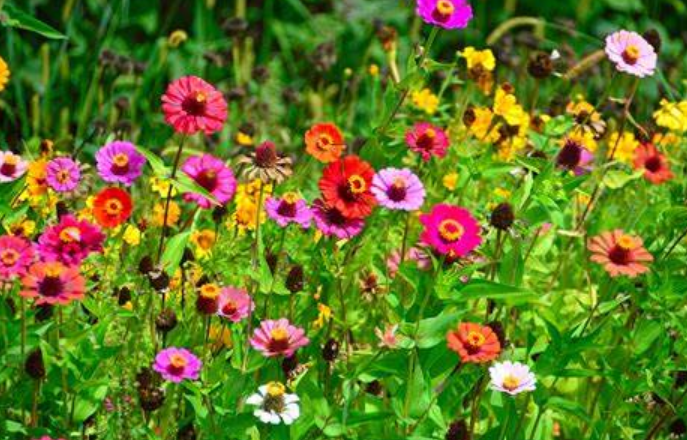

La primera parte tratará de seleccionar los algoritmos o técnicas que nos permitan crear estas representaciones vectoriales de las imágenes. Seguidamente se realizará un análisis exhaustivo y visualización de las características de cara a estudiar la efectividad de las técnicas seleccionadas. Una vez hecho esto se realizarán diferentes experimentos para realizar la búsqueda, estos experimentos servirán para demostrar que técnicas son más efectivas en este caso, que sucede dependiendo de los vectores empleados y que pasaría si combinamos varias características extraídas con diferentes algoritmos en la búsqueda.

## Análisis exploratorio de datos
En primer lugar se va a comenzar con un análisis exploratorio de datos de cara a entender el dataset proprocionado, el número de imágenes por especie, el tamaño de las imágenes entre otras características generales que se puedan analizar previo al análisis en sí de las imágenes mediante técnicas y algoritmos aplicados sobre ellas.

In [6]:
path_to_flowers_queries= main_datasets_path+"Flores_Query"

In [7]:
path_to_flowers_dataset = main_datasets_path+"Dataset_Flores"

Primero observamos las 17 distintas especies de flores que vamos a buscar:

In [8]:
species = os.listdir('./content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores')
species

['Bluebell',
 'Buttercup',
 'Coltsfoot',
 'Cowslip',
 'Crocus',
 'Daffodil',
 'Daisy',
 'Dandelion',
 'Fritillary',
 'Iris',
 'Lilyvalley',
 'Pansy',
 'Snowdrop',
 'Sunflower',
 'Tigerlily',
 'Tulip',
 'Windflower']

Número de imagenes por especie:

In [9]:

species_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores/'
species = os.listdir(species_path)

species_count = {}
for specie in species:
    specie_path = os.path.join(species_path, specie)
    if os.path.isdir(specie_path):
        images = os.listdir(specie_path)
        species_count[specie] = len(images)

species_count


{'Bluebell': 79,
 'Buttercup': 79,
 'Coltsfoot': 79,
 'Cowslip': 79,
 'Crocus': 79,
 'Daffodil': 79,
 'Daisy': 79,
 'Dandelion': 79,
 'Fritillary': 79,
 'Iris': 80,
 'Lilyvalley': 79,
 'Pansy': 79,
 'Snowdrop': 79,
 'Sunflower': 79,
 'Tigerlily': 79,
 'Tulip': 79,
 'Windflower': 79}

Observamos que todas las especies tienen 79 imagenes excepto iris que tiene 80

Ahora analizaremos los tamaños de las imágenes:

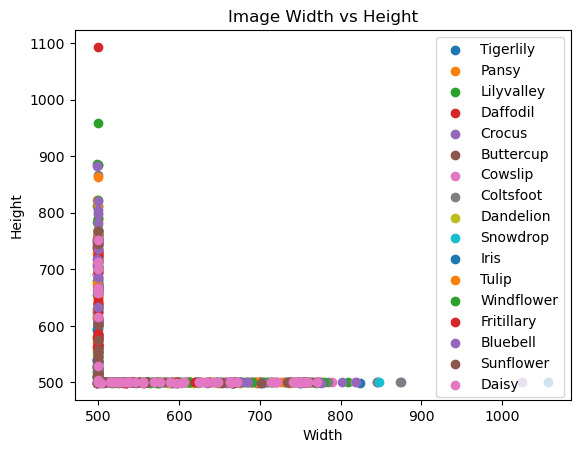

In [10]:
# Directory path
directory = species_path

# Initialize lists to store width and height
widths = []
heights = []

# Initialize a list to store the species names
species_names = []

# Iterate over each folder in the directory
for folder in os.listdir(directory):
    folder_path = os.path.join(directory, folder)
    if os.path.isdir(folder_path):
        # Iterate over each image in the folder
        for image_file in os.listdir(folder_path):
            image_path = os.path.join(folder_path, image_file)
            if os.path.isfile(image_path):
                # Open the image and get its width and height
                I = io.imread(image_path)
                h, w, _ = I.shape
                heights.append(h)
                widths.append(w)
                species_names.append(folder)  # Add the species name to the list

# Create a list of unique species names
unique_species = list(set(species_names))

# Plot the graph with different colors for each species
for species in unique_species:
    # Get the indices of images belonging to the current species
    indices = [i for i, name in enumerate(species_names) if name == species]
    # Plot the scatter plot for the current species with a unique color
    plt.scatter([widths[i] for i in indices], [heights[i] for i in indices], label=species)

# Add legend and labels
plt.xlabel('Width')
plt.ylabel('Height')
plt.title('Image Width vs Height')
plt.legend()
plt.show()

Analizando este gráfico sacamos la conclusión de que, al menos en una de las 2 dimensiones, las imágenes miden 500 pixeles, mientras que la otra es variable, abarcando un máximo de 1100 pixeles.

La mayoría de las dimensiones se mantinen entre los 500 y 800 pixeles

También podemos observar que no hay diferencia entre las especies a la hora del tamaño de las fotos.

## Aplicación de descriptores de imagen
Dado el caracter del dataset, numerosos descriptores pueden ser empleados para el análisis de las imágenes. En este caso nos vamos a centrar en tres casos específicos.

- Color: Histograma RGB
- Forma: Histograma de gradientes orientados (HOG)
- Textura: Patrones binarios locales (LBP)

Se puede ver claramente que analizar el color de las imágenes es fundamental para realizar un búscado con estas imágenes de flores. Para ello se extraerá el histograma de color RGB y se comparará entre diferentes especies de flores para ver si es representativo y que ventajas o inconvenientes presenta. En segundo lugar, se observa que dependiendo del tipo de flor la forma (pétalos, hojas...) es algo bastante representativo de cada una de ellas. Por tanto, se empleará el algoritmo HoG para extraer un representación vectorial de la forma de las flores para poder diferenciar entre ellas en base a esta característica. Finalmente, la textura puede ser otro descriptor que ayude a la búsqueda pues algunas flores presentan pétalos más rugosos o semillas en el centro entre otras diferencias que pueden ser analizadas mediante esta característica empleado, por ejemplo, el algoritmo LBP.

Por tanto para este apartado se pide que selecciones al menos 5 especies lo más diferentes posibles entre ellas y analice una imagen de cada una de ellas mediante la aplicación de las tres técnicas presentadas anteriormente. Se pide que se represente todo lo posible d emanera visual y se detallen las explicaciones y conclusiones que extraiga de sus resultados. Justifique los parámetros empleados en cada uno de los algoritmos y porqué los ha seleccionado de esa manera.

Selección de 5 especies:

In [11]:
especies=["Snowdrop","Tulip","Sunflower","Tigerlily","Bluebell"]
#Hemos selecionado estas 5 especoes porque consideramos que son muy distintas entre si

##Histogtama RGB:

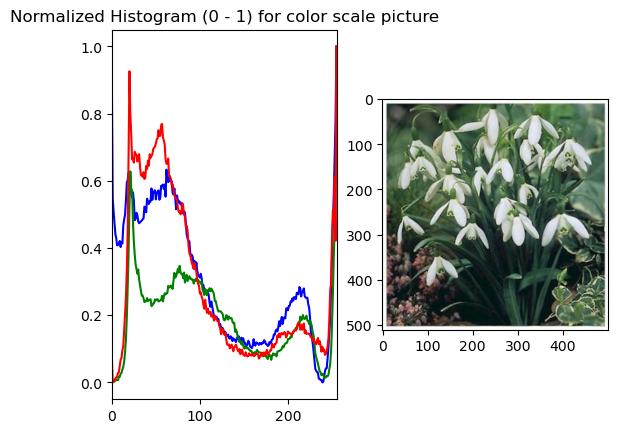

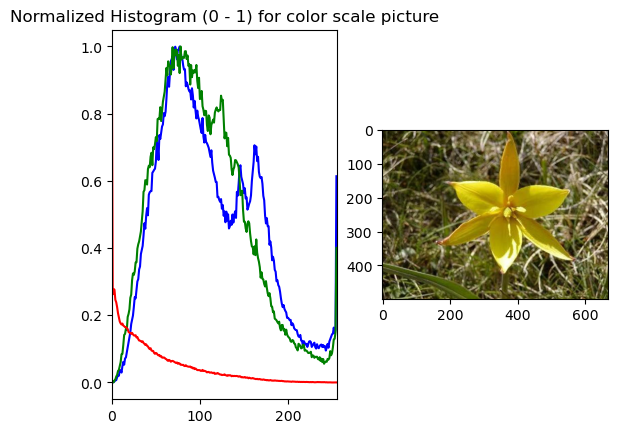

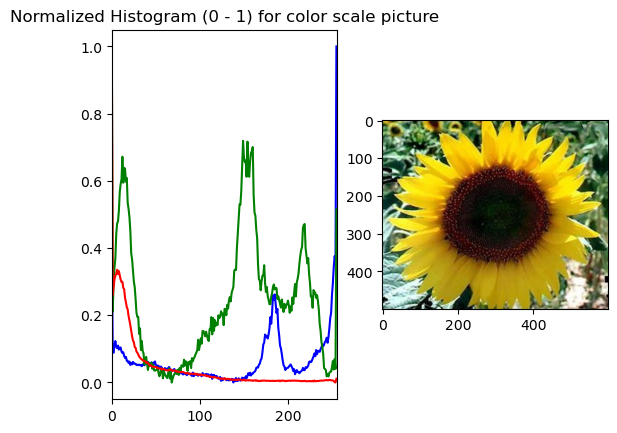

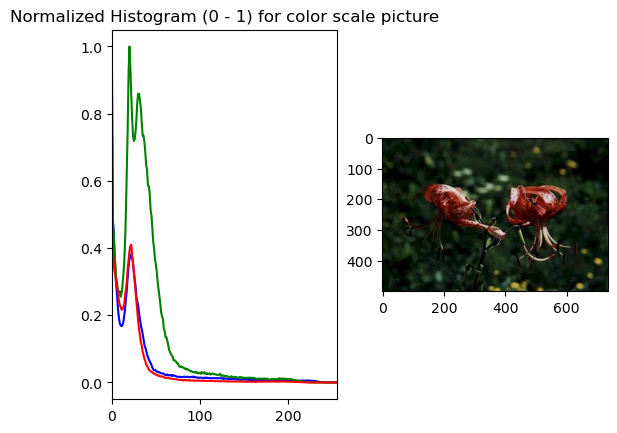

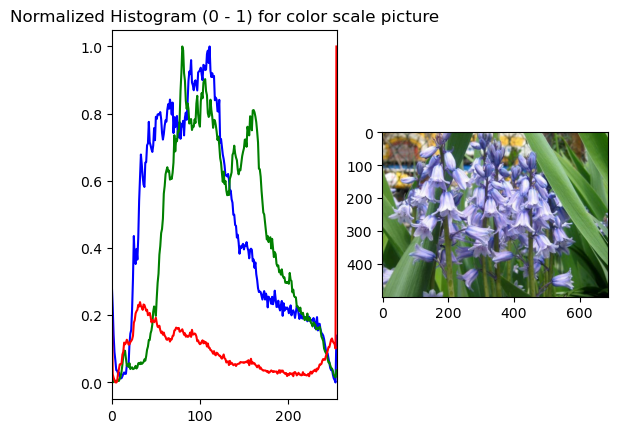

In [12]:

# Iterate over each species
for especie in especies:
    ruta=species_path +  especie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]

    # Select a random image file
    random_image_file = np.random.choice(image_files)
    # Load the image
    image_path = os.path.join(ruta, random_image_file)
    image = cv2.imread(image_path)

    # Convert the image to RGB colorspace
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    color = ('b','g','r')
    hist_b = None
    hist_g = None
    hist_r = None
    for channel,col in enumerate(color):
      histr = cv2.calcHist([image_rgb],[channel],None,[256],[0,256])
      cv2.normalize(histr, histr, 0, 1, cv2.NORM_MINMAX)
      plt.subplot(1, 2, 1)
      plt.plot(histr,color = col)
      plt.xlim([0,256])
      if col == 'b':
          hist_b = histr.copy()
      elif col == 'g':
          hist_g = histr.copy()
      elif col == 'r':
          hist_r = histr.copy()

    plt.title('Normalized Histogram (0 - 1) for color scale picture')
    plt.subplot(1, 2, 2)
    plt.imshow(image_rgb)

    # Show the plot
    plt.show()

Lo primero que se puede sacar de estas gráficas es que el color verde es muy dominante en todas las flores. Esto se debe a que el fondo suele ser verde (cesped, hierbas, etc) sumado a que los porpios tallos de las flores también suelen serlo.
El resto de gamas cromáticas corresponde al de la flor, por lo que si que sería posible diferenciarlas por el histograma (siempre y cuando no haya 2 especies de flores con los mismos colores)

##Histogtama HOG:

Snowdrop


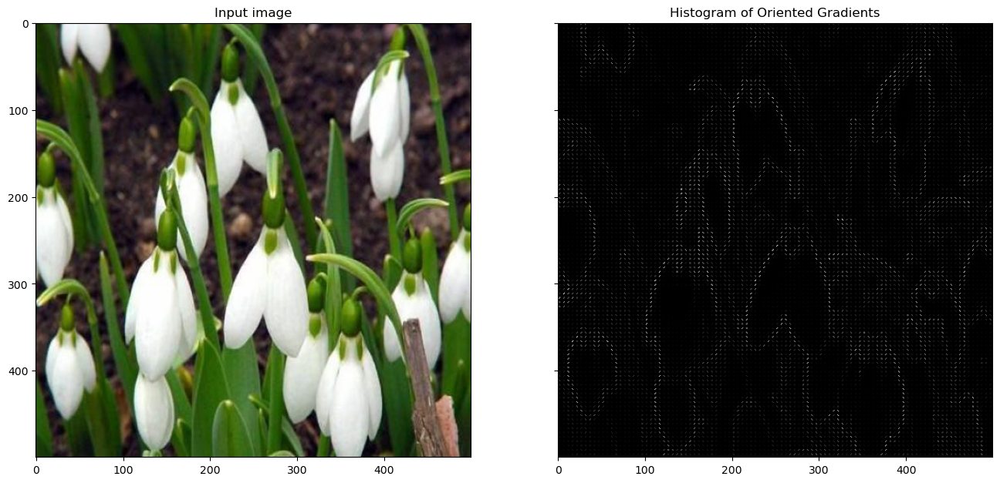

Tulip


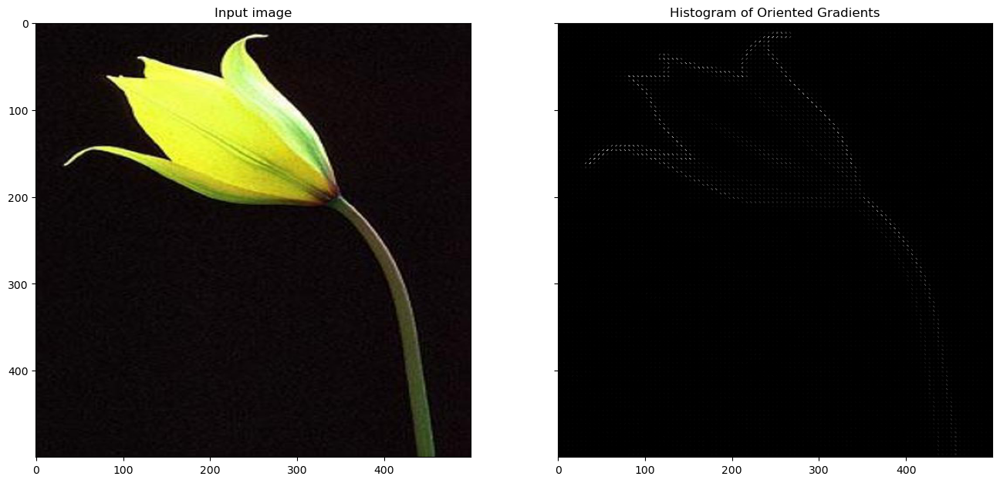

Sunflower


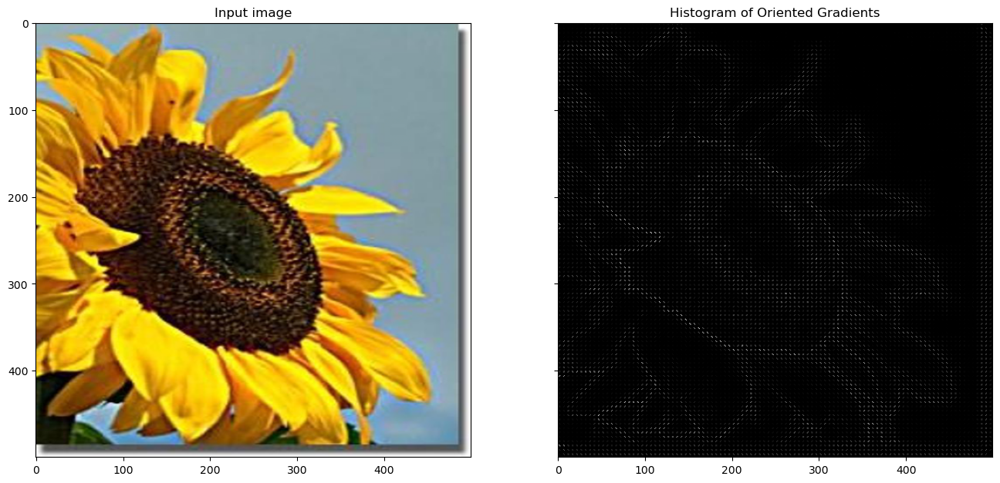

Tigerlily


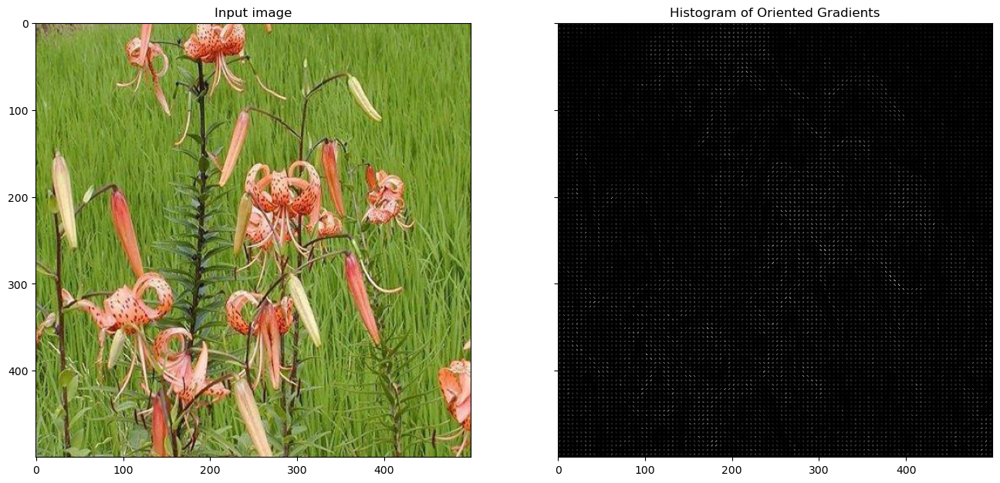

Bluebell


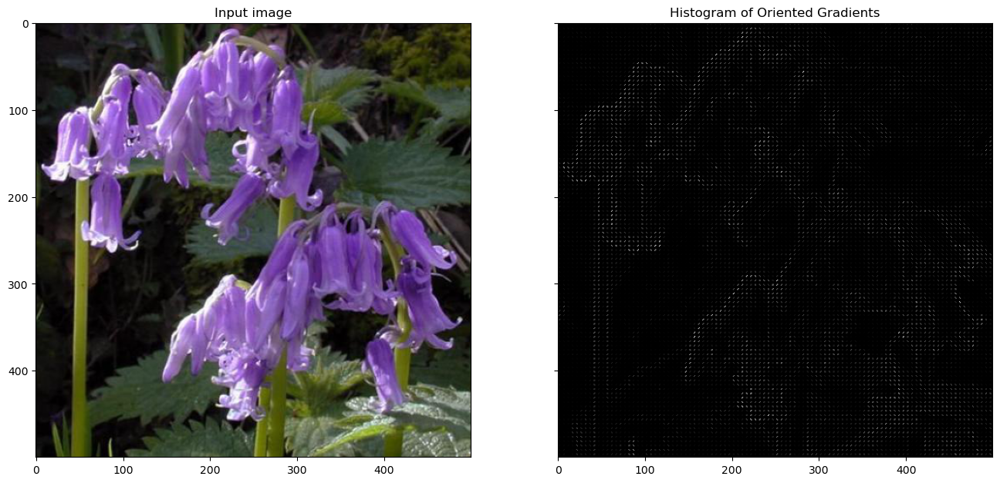

In [13]:
# Iterate over each species
for especie in especies:
    ruta=species_path+especie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]

    # Select a random image file
    random_image_file = np.random.choice(image_files)
    # Load the image
    image_path = os.path.join(ruta, random_image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    resized_img = resize(image, (500,500))
    fd, hog_image = hog(resized_img, orientations=10, pixels_per_cell=(5, 5), cells_per_block=(10, 10), visualize=True, channel_axis=-1)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)
    print(especie)
    ax1.imshow(resized_img, cmap=plt.cm.gray)
    ax1.set_title('Input image')

    # Rescale histogram for better display
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax2.set_title('Histogram of Oriented Gradients')

    plt.show()

Para que los vectores tengan la misma dimensión, es necesario que todas las imagenes tengan el mismo tamaño.Hemos decidido redimensionar las imagenes a 500x500 ya que, como vimos antes, todas las imagenes tienen ese valor en al menos una dimensión, y la imagen apenas se vera afectada por este redimensionamiento.

En cuanto a los parámetros, hemos decidido poner 10 distintas orientacciones de los gradientes ya que consderamos que las flores son elementos que pueden llegar a ser complejos y tener muchos detalles. El numero de pixeles por celda lo hemos puesto 5x5 para que capte también bien los detalles. Por ultimo los valores de celda/bloque mas altos indican mas invafrianza a la iluminación y al contraste pero reduce la sensibilidad a detalles, es por eso que hemos puesto un valor bajo (2)

Podemos observar que en las flores grandes si que son muy reconocibles los vectores, como por ejemplo en el girasol, sin embargo, para flores pequeñas cuesta mas y es mas confuso si ademas hay ramas o tallos por el medio

Ahora hacemos una pequeña demostración en la que podemos ver que realmente no se nota tanto la diferencia al poner mas orientaciones (10 y 100)

Snowdrop


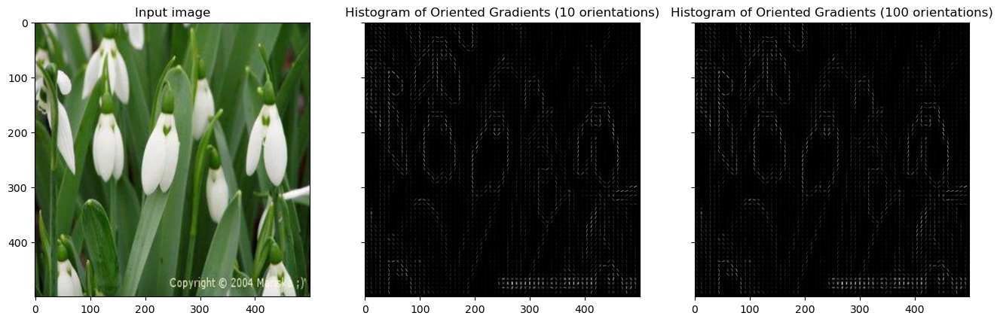

Tulip


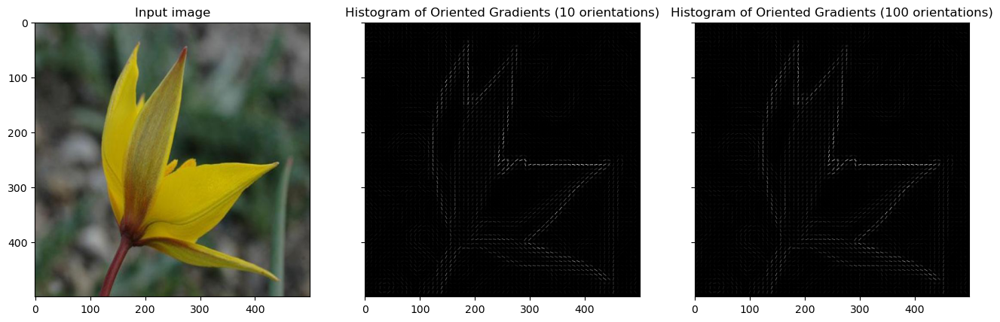

Sunflower


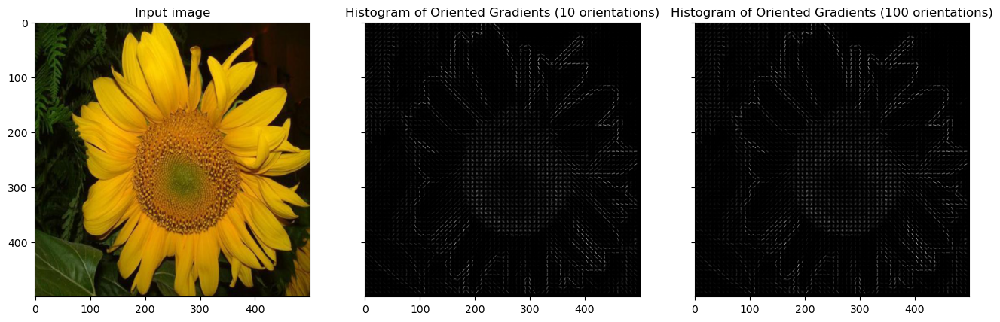

Tigerlily


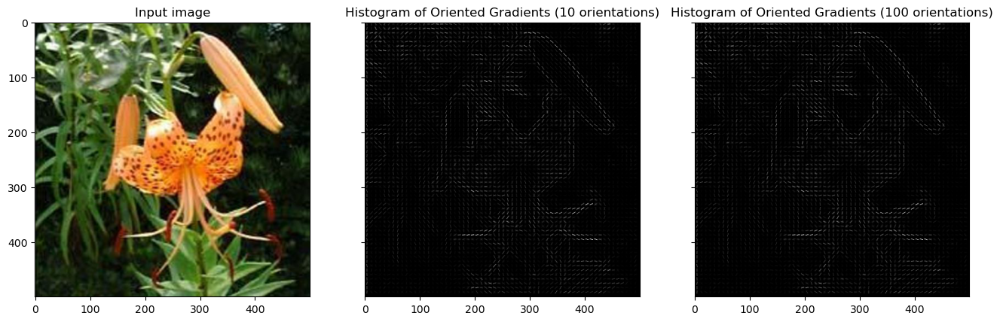

Bluebell


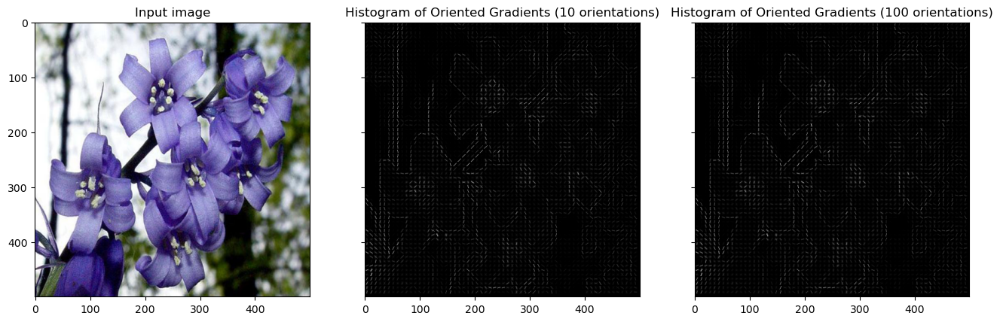

In [14]:
# Iterate over each species
for especie in especies:
    ruta=species_path+especie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]

    # Select a random image file
    random_image_file = np.random.choice(image_files)
    # Load the image
    image_path = os.path.join(ruta, random_image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    resized_img = resize(image, (500,500))
    fd, hog_image = hog(resized_img, orientations=10, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True,channel_axis=-1 )
    fig, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(16, 8), sharex=True, sharey=True)
    print(especie)
    ax1.imshow(resized_img, cmap=plt.cm.gray)
    ax1.set_title('Input image')

    # Rescale histogram for better display
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax2.set_title('Histogram of Oriented Gradients (10 orientations)')

    fd, hog_image = hog(resized_img, orientations=100, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
    ax3.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax3.set_title('Histogram of Oriented Gradients (100 orientations)')
    plt.show()

Sin embargo los pixeles por celda si que se nota mas:

Snowdrop


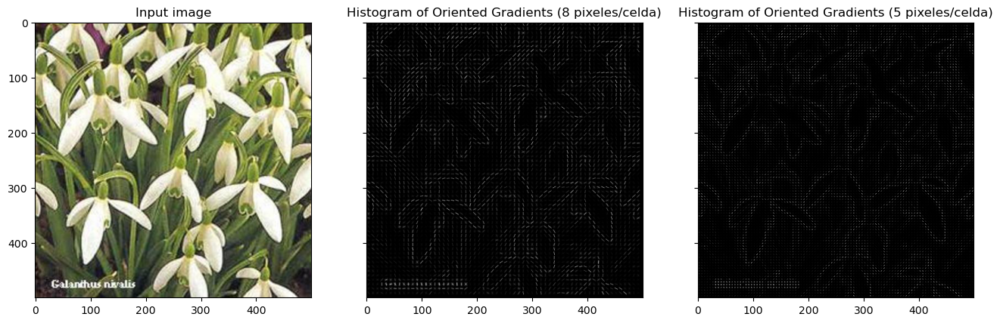

Tulip


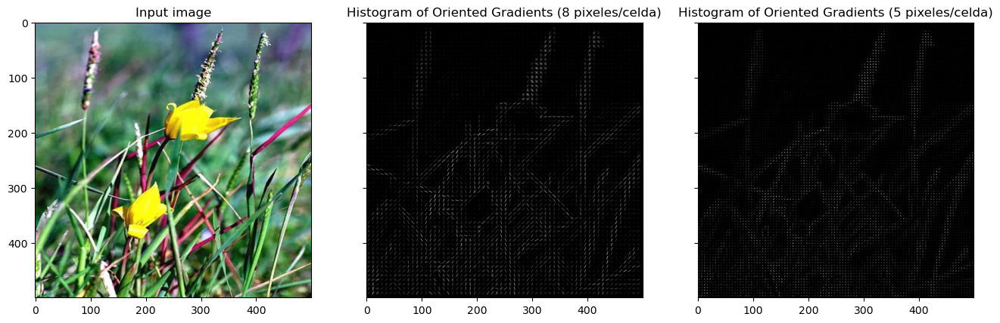

Sunflower


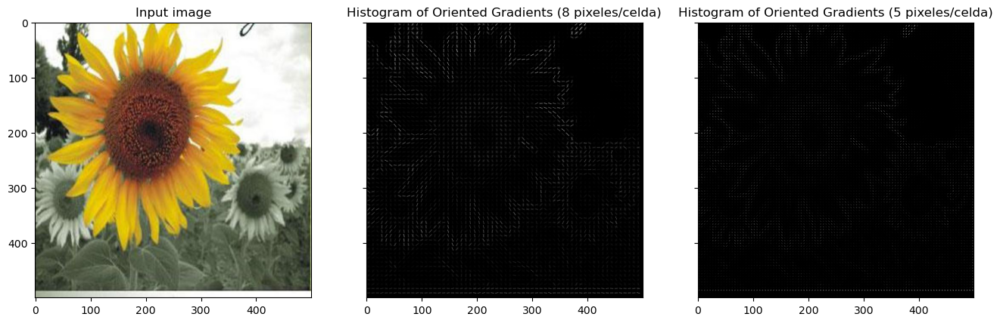

Tigerlily


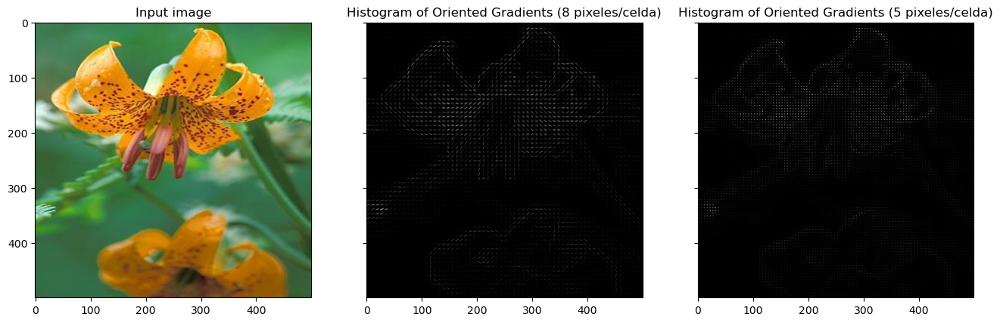

Bluebell


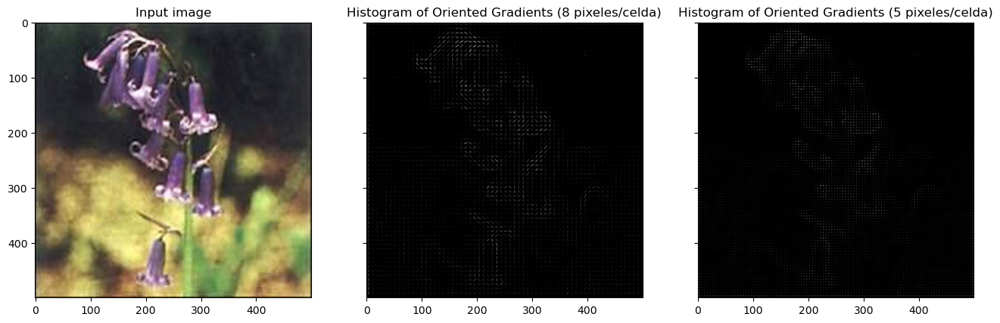

In [15]:
# Iterate over each species
for especie in especies:
    ruta=species_path+especie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]

    # Select a random image file
    random_image_file = np.random.choice(image_files)
    # Load the image
    image_path = os.path.join(ruta, random_image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    resized_img = resize(image, (500,500))
    fd, hog_image = hog(resized_img, orientations=10, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True,channel_axis=-1 )
    fig, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(16, 8), sharex=True, sharey=True)
    print(especie)
    ax1.imshow(resized_img, cmap=plt.cm.gray)
    ax1.set_title('Input image')

    # Rescale histogram for better display
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax2.set_title('Histogram of Oriented Gradients (8 pixeles/celda)')

    fd, hog_image = hog(resized_img, orientations=10, pixels_per_cell=(5, 5), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
    ax3.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax3.set_title('Histogram of Oriented Gradients (5 pixeles/celda)')
    plt.show()

Ahora realizamos una ultima prueba con el tamaño de los bloques:

Snowdrop


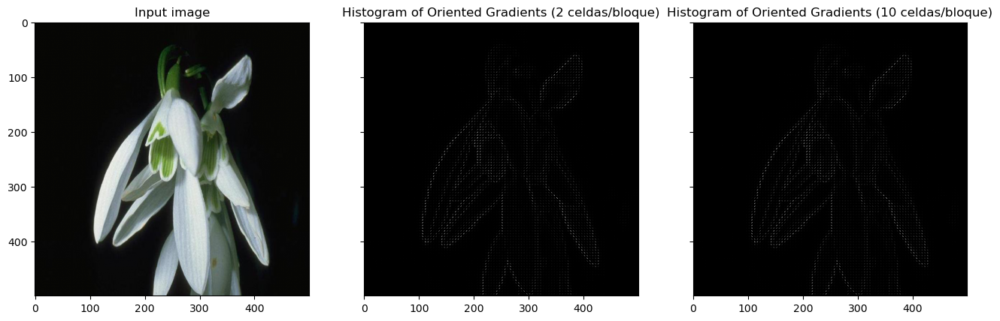

Tulip


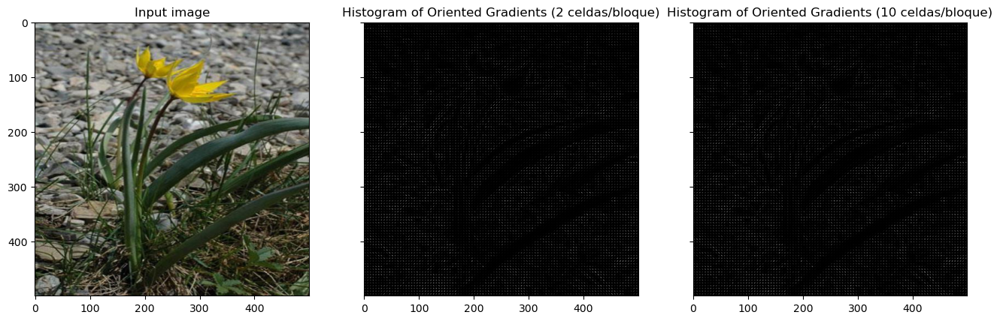

Sunflower


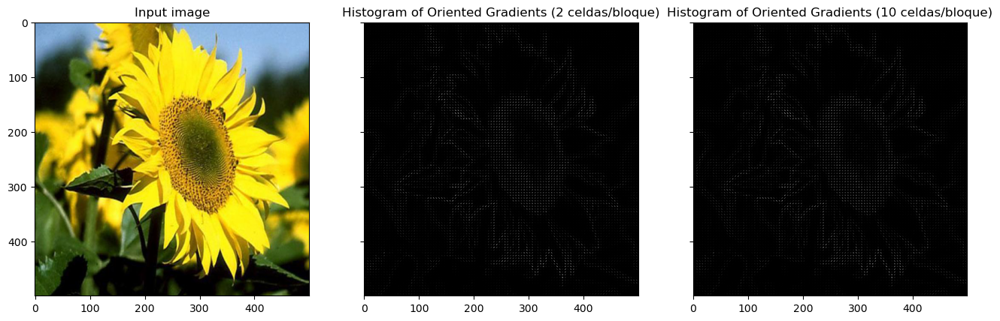

Tigerlily


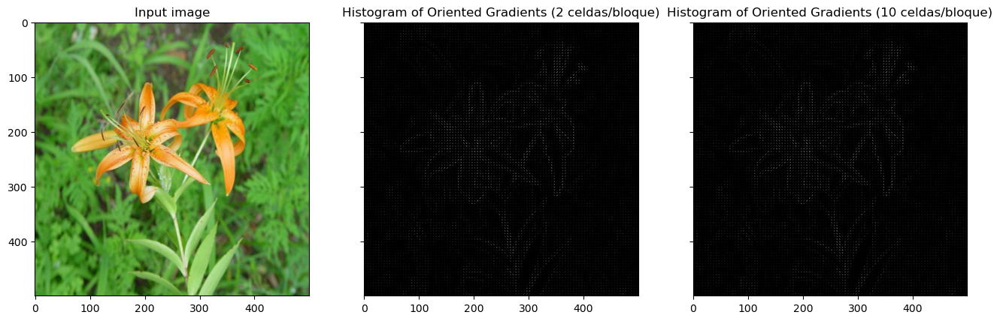

Bluebell


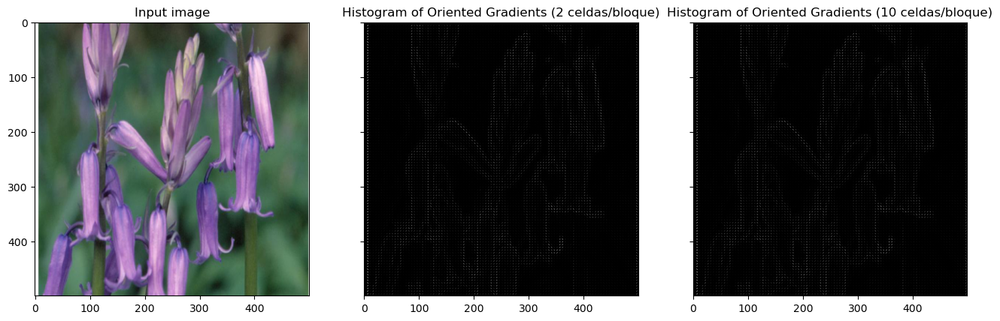

In [16]:
# Iterate over each species
for especie in especies:
    ruta=species_path+especie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]

    # Select a random image file
    random_image_file = np.random.choice(image_files)
    # Load the image
    image_path = os.path.join(ruta, random_image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    resized_img = resize(image, (500,500))
    fd, hog_image = hog(resized_img, orientations=10, pixels_per_cell=(5, 5), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
    fig, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(16, 8), sharex=True, sharey=True)
    print(especie)
    ax1.imshow(resized_img, cmap=plt.cm.gray)
    ax1.set_title('Input image')

    # Rescale histogram for better display
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax2.set_title('Histogram of Oriented Gradients (2 celdas/bloque)')

    fd, hog_image = hog(resized_img, orientations=10, pixels_per_cell=(5, 5), cells_per_block=(100, 100), visualize=True, channel_axis=-1)
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
    ax3.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax3.set_title('Histogram of Oriented Gradients (10 celdas/bloque)')
    plt.show()

Vemos que las imagenes son muy similares, por no decir idénticos

##Patrones binarios locales:

Snowdrop


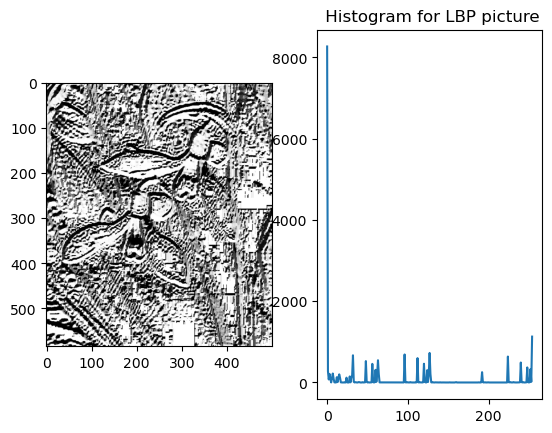

Tulip


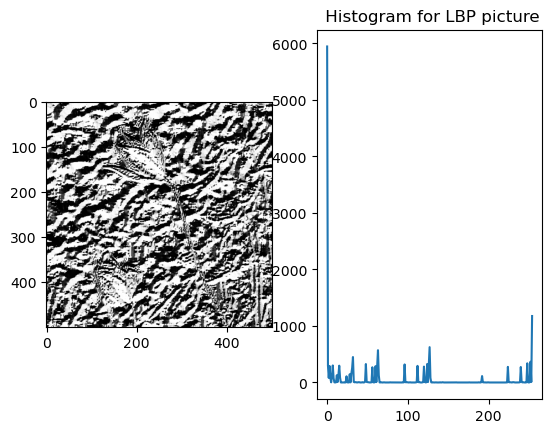

Sunflower


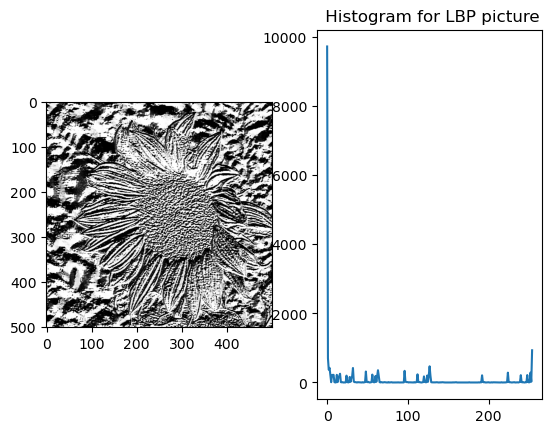

Tigerlily


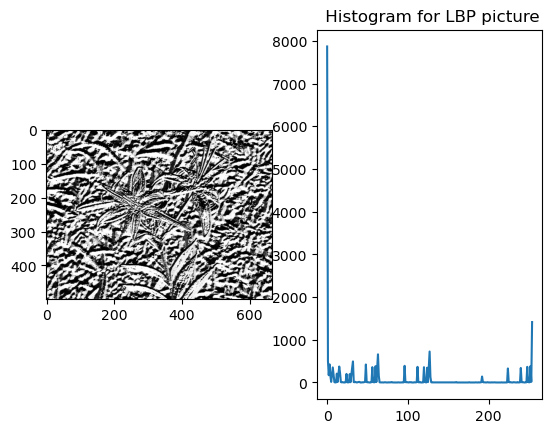

Bluebell


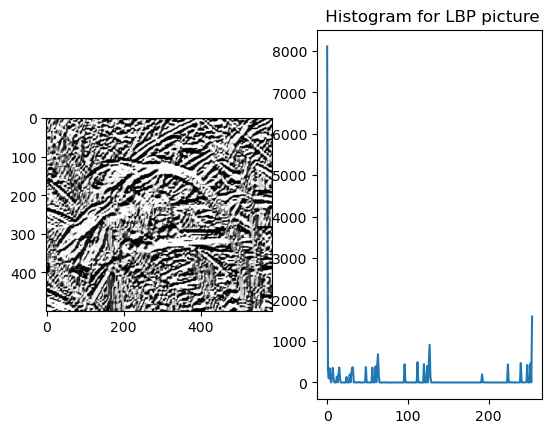

In [17]:
for especie in especies:
    ruta=species_path+especie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]
    # Select a random image file
    random_image_file = np.random.choice(image_files)
    # Load the image
    image_path = os.path.join(ruta, random_image_file)

    gray = cv2.imread(image_path,0)
    # define the parameters of the Local Binary Patterns
    numPoints = 20
    radius = 3
    # extract the histogram of Local Binary Patterns
    lbp = feature.local_binary_pattern(gray, numPoints, radius, method="default")
    (hist, _) = np.histogram(lbp.ravel(), bins=range(0, 256))
    print(especie)
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(lbp.astype("uint8"), cv2.COLOR_BGR2RGB))
    plt.subplot(1, 2, 2)
    plt.plot(hist)
    plt.title(' Histogram for LBP picture')
    plt.show()

Hemos elegido un valor de numPoints relativamente alto porque al abarcar un mayor numero de puntos se pueden detectar patrones mas complejos. Del mismo modo hemos elegido un radio bajo para que se centre en la detección de texturas y detalles finos, ya que las flores suelen ser complejas y con diversas texturas.

## Análisis en reducción de dimensionalidad
De cara a explorar más en detalle los vectores extraídos, puede emplear técnicas de reducción de dimensionalidad, clustering, entre otras para visualizar los resultados en gráficos y ver si existen diferencias notables en los vectores de características. Nota: Debe tener en cuenta que las técnicas HoG y LBP crean los vectores de características de una forma particular que debe conocer y tener en cuenta para el análisis.

In [9]:
class RGBHistogram:
	def __init__(self, bins):
		# store the number of bins the histogram will use
		self.bins = bins

	def describe(self, image):
		# compute a 3D histogram in the RGB colorspace,
		# then normalize the histogram so that images
		# with the same content, but either scaled larger
		# or smaller will have (roughly) the same histogram
		hist = cv2.calcHist([image], [0, 1, 2],
			None, self.bins, [0, 256, 0, 256, 0, 256])
		hist = cv2.normalize(hist,hist)

		# return out 3D histogram as a flattened array
		return hist.flatten()

In [19]:
RGB=[]
HOG=[]
LBP=[]

# Create an instance of the RGBHistogram class
histogram = RGBHistogram([8, 8, 8])

for especie in especies:
    ruta=species_path+especie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]

    for imagen in image_files:
		    # Load the image
        image_path = os.path.join(ruta, imagen)
        image = cv2.imread(image_path)
        resized_img = resize(image, (500,500))

		#RGB 
        image_rgb=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        features = histogram.describe(image)
        RGB.append(features)

        #HOG
        fd, hog_image = hog(resized_img, orientations=7, pixels_per_cell=(8, 8), cells_per_block=(5, 5), visualize=True, channel_axis=-1)
        HOG.append(fd)

        #LBP
        lbp = feature.local_binary_pattern(gray, numPoints, radius, method="default")
        LBP.append(lbp.ravel())

print(RGB)
print(HOG)
print(LBP)


[array([7.4952835e-01, 1.6786531e-02, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       5.1323813e-01, 2.9311207e-01, 3.6915019e-03, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       1.1083031e-04, 2.0553055e-01, 5.1101301e-02, 8.5254083e-05,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 7.9797823e-03, 7.5125903e-02, 7.4085803e-03,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 2.3615381e-03, 1.5592973e-02,
       3.5806716e-04, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 8.5254083e-05,
       3.9216879e-04, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000

Comprobamos las dimensiones de los vectores:

In [20]:
print(len(RGB))
print(len(HOG))
print(len(LBP))
print(len(RGB[0]))
print(len(HOG[0]))
print(len(LBP[0]))



395
395
395
512
588700
292500


Ahora aplicaremos clustering reduciendo la dimensionalidad con PCA y TSNE

Primero definiremos el modelo de clasificación que vamos a usar, en este caso, kmeans:
El numero de clusters será el numero de especiesm en nuestro caso, 5

In [21]:
from sklearn.cluster import KMeans
n_clusters = 5
kmeans = KMeans(n_clusters=n_clusters)

### CLUSTERING CON PCA

c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


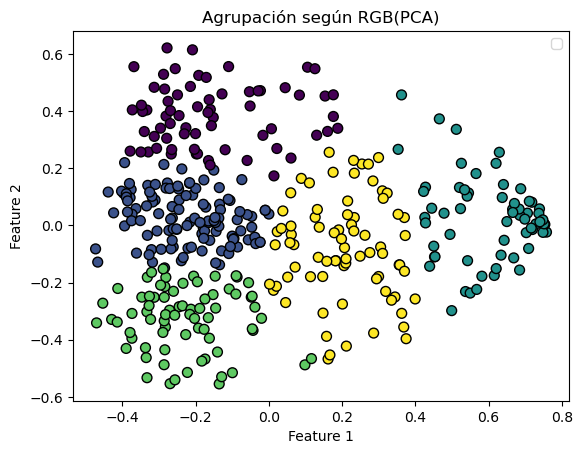

In [22]:
from sklearn.decomposition import PCA
componentes = 2 #fijamos el nuemro de componentes al que queremos reducir la dimensionalidad 
pca=PCA(n_components=componentes)

RGB_PCA=pca.fit_transform(RGB)
RGB_KMEANS = kmeans.fit_predict(RGB_PCA)
plt.scatter(RGB_PCA[:, 0], RGB_PCA[:, 1], c=RGB_KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según RGB(PCA)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()
plt.show()



c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


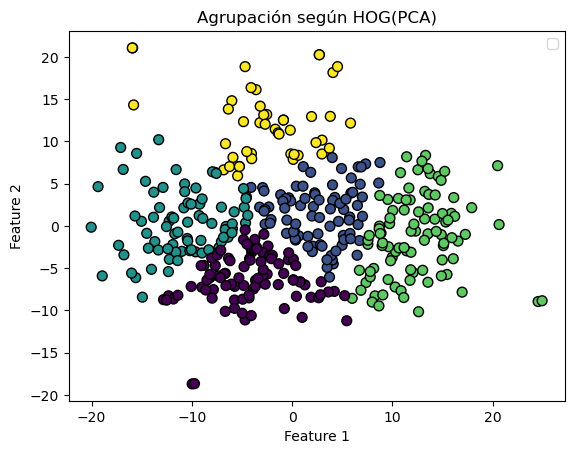

In [23]:
#divide HOG in 3 for avoiding overcommit
HOG1 = HOG[:int(len(HOG)/3)]
HOG2 = HOG[int(len(HOG)/3):int(2*len(HOG)/3)]
HOG3 = HOG[int(2*len(HOG)/3):]
#apply PCA to each part and then join them
HOG1=pca.fit_transform(HOG1)
HOG2=pca.fit_transform(HOG2)
HOG3=pca.fit_transform(HOG3)
HOG_PCA = np.concatenate((HOG1,HOG2,HOG3), axis=0)

HOG_KMEANS = kmeans.fit_predict(HOG_PCA)
plt.scatter(HOG_PCA[:, 0], HOG_PCA[:, 1], c=HOG_KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según HOG(PCA)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()
plt.show()



c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\decomposition\_pca.py:640: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\base.py:1151: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwar

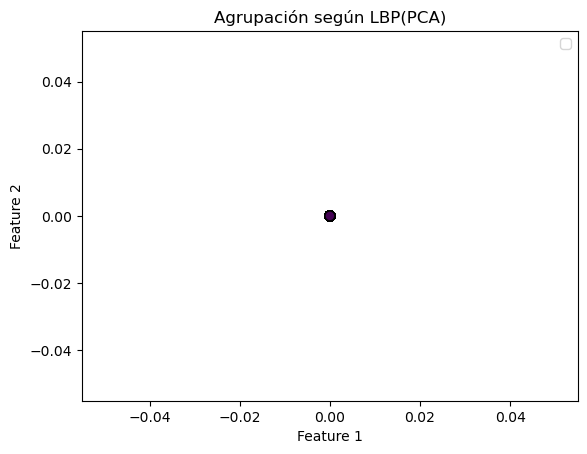

In [24]:

LBP_PCA=pca.fit_transform(LBP)
LBP_KMEANS = kmeans.fit_predict(LBP_PCA)
plt.scatter(LBP_PCA[:, 0], LBP_PCA[:, 1], c=LBP_KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según LBP(PCA)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()
plt.show()


### CLUSTERING CON TSNE

In [25]:
from sklearn.manifold import TSNE
componentes = 2 #fijamos el nuemro de componentes al que queremos reducir la dimensionalidad
tsne=TSNE(n_components=componentes)

c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


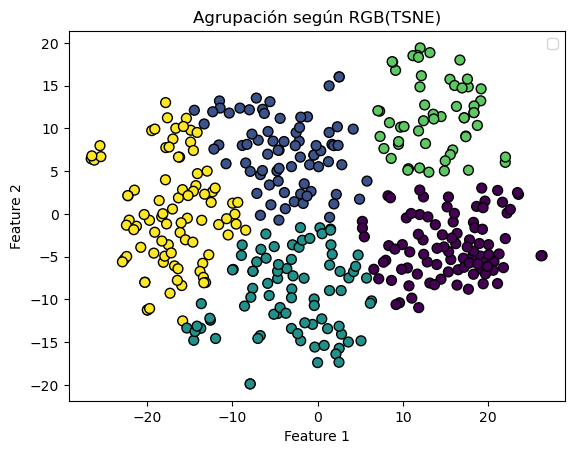

In [26]:
RGB=np.array(RGB)
RGB_TSNE=tsne.fit_transform(RGB)
RGB_KMEANS = kmeans.fit_predict(RGB_TSNE)
plt.scatter(RGB_TSNE[:, 0], RGB_TSNE[:, 1], c=RGB_KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según RGB(TSNE)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()


c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


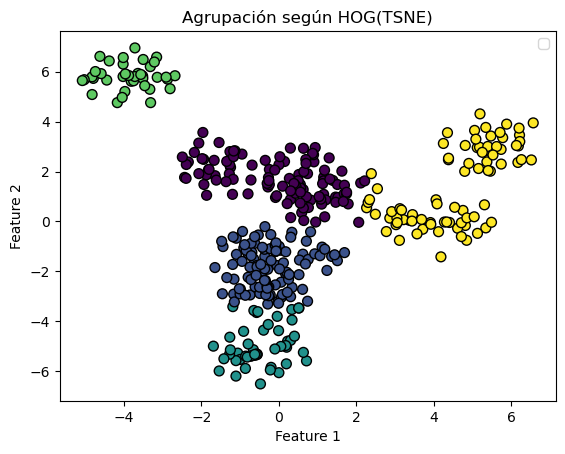

In [27]:
#divide HOG in 10 for avoiding overcommit
HOG1 = np.array(HOG[:int(len(HOG)/10)])
HOG2 = np.array(HOG[int(len(HOG)/10):int(2*len(HOG)/10)])
HOG3 = np.array(HOG[int(2*len(HOG)/10):int(3*len(HOG)/10)])
HOG4 = np.array(HOG[int(3*len(HOG)/10):int(4*len(HOG)/10)])
HOG5 = np.array(HOG[int(4*len(HOG)/10):int(5*len(HOG)/10)])
HOG6 = np.array(HOG[int(5*len(HOG)/10):int(6*len(HOG)/10)])
HOG7 = np.array(HOG[int(6*len(HOG)/10):int(7*len(HOG)/10)])
HOG8 = np.array(HOG[int(7*len(HOG)/10):int(8*len(HOG)/10)])
HOG9 = np.array(HOG[int(8*len(HOG)/10):int(9*len(HOG)/10)])
HOG10 = np.array(HOG[int(9*len(HOG)/10):])
#apply TSNE to each part and then join them
HOG1=tsne.fit_transform(HOG1)
HOG2=tsne.fit_transform(HOG2)
HOG3=tsne.fit_transform(HOG3)
HOG4=tsne.fit_transform(HOG4)
HOG5=tsne.fit_transform(HOG5)
HOG6=tsne.fit_transform(HOG6)
HOG7=tsne.fit_transform(HOG7)
HOG8=tsne.fit_transform(HOG8)
HOG9=tsne.fit_transform(HOG9)
HOG10=tsne.fit_transform(HOG10)
HOG_TSNE = np.concatenate((HOG1,HOG2,HOG3,HOG4,HOG5,HOG6,HOG7,HOG8,HOG9,HOG10), axis=0)
#draw
HOG_KMEANS = kmeans.fit_predict(HOG_TSNE)
plt.scatter(HOG_TSNE[:, 0], HOG_TSNE[:, 1], c=HOG_KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según HOG(TSNE)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()
plt.show()




In [28]:
LBP=np.array(LBP)
LBP_TSNE=tsne.fit_transform(LBP)
LBP_KMEANS = kmeans.fit_predict(LBP_TSNE)
plt.scatter(LBP_TSNE[:, 0], LBP_TSNE[:, 1], c=LBP_KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según LBP(TSNE)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()



: 

Analizando los gráficos resultantes de clusterizar con PCA y TSNE podemos sacar varias conclusiones:
    -La mejor agrupación es según RGB ya que es la que crea clusters mas definidos en ambos casos
    -La agrpación según LBP da resultados muy malos ya que todos los clusters son muy similares y se concentran en un único punto
    -RGB agrupa mejor con TSNE mientras que HOG con PCA ya que se generan mas outliers

## Creación de la base de datos de vectores de características
Para realizar la búsqueda se va a crear una base de datos que almacene todos los vectores de características de todas las imágenes. Para esto puede emplear soluciones que se han visto durante las prácticas de la asignatura. Lo que interesa ahora es extraer de cada imagen el vector de características de cada una de las tres técnicas empleadas. Nota: Recuerde que para los algoritmos HoG y LBP las imágenes deben reescalarse a un tamaño similar sino los vectores de características tendrán tamaños diferentes. Por tanto, decida previamente el tamaño por defecto al que se reescalarán todas las imágenes.

Creamos un diccionario que para cada imagen de todas las especies guarde los vectores de RGB, HOG Y LBP

In [2]:
species_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores/'
species = os.listdir(species_path)
for specie in species:
    ruta=species_path+specie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]
    for image_name in image_files:
        image_path = os.path.join(ruta, image_name)
        image = cv2.imread(image_path)
        resized_img = resize(image, (500,500))
        break

In [74]:
print(image.shape)
print(resized_img.shape)

(518, 500, 3)
(500, 500, 3)


In [80]:
db={}
species_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores/'
species = os.listdir(species_path)
rgb = RGBHistogram([8, 8, 8])
for specie in species:
    ruta=species_path+specie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]
    for image_name in image_files:
      db[image_name]={}
      # Load the image
      image_path = os.path.join(ruta, image_name)
      image = cv2.imread(image_path)
      # Convert the image to RGB colorspace
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      #Primero creamos el vector del histograma RGB
      features = rgb.describe(image_rgb)
      db[image_name]["RGB"]=features

      #Ahora creamos el vector del histograma HOG
      resized_img = resize(image, (500,500))
      fd, hog_image = hog(resized_img, orientations=7, pixels_per_cell=(8, 8), cells_per_block=(5, 5), visualize=True, channel_axis=-1)
      db[image_name]["HOG"]=fd
      
      # Create the LBP vector
      # Resize the image to the same size as the HOG images
      gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
      resized_gray = resize(gray, (500,500), mode='reflect', anti_aliasing=True)
      lbp = feature.local_binary_pattern(resized_gray, numPoints, radius, method="default")
      db[image_name]["LBP"]=lbp.ravel()
      




c:\Users\dcobo\anaconda3\Lib\site-packages\skimage\feature\texture.py:353: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


Guardamos la base de datos en un archivo .pickle:

In [47]:
"""
import pickle
index_name="base_de_datos_flores"
outputFile = open(index_name +".pkl", "wb")
pickle.dump(db, outputFile)
outputFile.close()

pickle.dumps(db)
"""

Comprobamos que la longitud es la correcta:

In [65]:
#shape of db
print(len(db))


1344
333000


## Desarrollo de la solución de búsqueda
Ahora debe desarrollar la solución que permita la búsqueda en la base de datos mediante una imágen "query" que se comparará con todas las de la base de datos. Para ello debe realizar la comparación del vector de características que desee emplear de la imagen query con el vector de características del mismo tipo de todas las imágenes de la base de datos. Para esto puede emplear por ejemplo una métrica de distancia de las más conocidas como la distancia euclídea, distancia del coseno, entre otras. Devuelva al menos los 10 primeros resultados más similares. Nota: Puede emplear las soluciones ya presentadas en algunas de las prácticas de la asignatura. Tenga en cuenta que se debe poder seleccionar que vector de características (Histograma RGB, HoG, LBP) se va a emplear para la comparación e incluso pueden usarser combinaciones de estos (Histograma RGB + LBP, Histograma RGB + HoG, HoG + LBP, Histograma RGB + LBP + HoG).

Creamos una función search que dada la base de datos, utilizando un vector de caracteristicas (feature) y una imagen (query) devuelve las n_results (por defecto 10) imagenes mas parecidas a la query en la base de datos según la feature elegida.La función realiza los calculos necesarios para conseguir los vectores. La busqueda se realiza mediante la distancia euclidea.
La función devuelve una lista con las imagenes mas parecidas en orden de la distancia euclidea.

In [4]:
def search(query, db, featuree, n_results=10):
    results = {}
    
    for key in db.keys():
        if featuree == "RGB":
            image_rgb = cv2.cvtColor(query, cv2.COLOR_BGR2RGB)
            features = rgb.describe(image_rgb)
            d = np.linalg.norm(db[key]["RGB"]-features)
        elif featuree == "HOG":
            resized_img = resize(query, (500,500))
            fd, hog_image = hog(resized_img, orientations=7, pixels_per_cell=(8, 8), cells_per_block=(5, 5), visualize=True, channel_axis=-1)
            d = np.linalg.norm(db[key]["HOG"]-fd)
            
        elif featuree == "LBP":
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            resized_gray = resize(gray, (500,500), mode='reflect', anti_aliasing=True)
            lbp = feature.local_binary_pattern(resized_gray, numPoints, radius, method="default")
            d = np.linalg.norm(db[key]["LBP"]-lbp.ravel())
            
        elif featuree == "RGB + HOG":
            image_rgb = cv2.cvtColor(query, cv2.COLOR_BGR2RGB)
            features = rgb.describe(image_rgb)
            resized_img = resize(query, (500,500))
            fd, hog_image = hog(resized_img, orientations=7, pixels_per_cell=(8, 8), cells_per_block=(5, 5), visualize=True, channel_axis=-1)
            d = np.linalg.norm(db[key]["RGB"]-features) + np.linalg.norm(db[key]["HOG"]-fd)
            
        elif featuree == "RGB + LBP":
            image_rgb = cv2.cvtColor(query, cv2.COLOR_BGR2RGB)
            features = rgb.describe(image_rgb)
            resized_img = resize(query, (500,500))
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            resized_gray = resize(gray, (500,500), mode='reflect', anti_aliasing=True)
            lbp = feature.local_binary_pattern(resized_gray, numPoints, radius, method="default")
            d = np.linalg.norm(db[key]["RGB"]-features) + np.linalg.norm(db[key]["LBP"]-lbp.ravel())
            
        elif featuree == "HOG + LBP":
            resized_img = resize(query, (500,500))
            fd, hog_image = hog(resized_img, orientations=7, pixels_per_cell=(8, 8), cells_per_block=(5, 5), visualize=True, channel_axis=-1)
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            resized_gray = resize(gray, (500,500), mode='reflect', anti_aliasing=True)
            lbp = feature.local_binary_pattern(resized_gray, numPoints, radius, method="default")
            d = np.linalg.norm(db[key]["HOG"]-fd) + np.linalg.norm(db[key]["LBP"]-lbp.ravel())
            
        elif featuree == "RGB + HOG + LBP":
            image_rgb = cv2.cvtColor(query, cv2.COLOR_BGR2RGB)
            features = rgb.describe(image_rgb)
            resized_img = resize(query, (500,500))
            fd, hog_image = hog(resized_img, orientations=7, pixels_per_cell=(8, 8), cells_per_block=(5, 5), visualize=True, channel_axis=-1)
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            resized_gray = resize(gray, (500,500), mode='reflect', anti_aliasing=True)
            lbp = feature.local_binary_pattern(resized_gray, numPoints, radius, method="default")
            d = np.linalg.norm(db[key]["RGB"]-features) + np.linalg.norm(db[key]["HOG"]-fd) + np.linalg.norm(db[key]["LBP"]-lbp.ravel())
        
        else:
            raise ValueError("Feature not supported, only supported: RGB, HOG, LBP, RGB + HOG, RGB + LBP, HOG + LBP, RGB + HOG + LBP")
        
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    return list(results.keys())[:n_results]



## Análisis de resultados
Realice varias búsquedas para probar su solución con las imágenes "query" que se proprocionan en la carpeta adicional. Pruebe a realizar búsquedas con cada vector de caracterísitcas extraído con cada técnica y con combinaciones de estos. Comente los resultados obtenidos en detalle, si cumplen las espectativas y que sucede con cada vector de características.

Primero creamos una función auxiliar para poder visualizar los resultados

In [5]:
def show_results(query, results, species, species_path):
    #imprime la imagen de query y las 10 imagenes del resulado
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 11, 1)
    plt.axis('off')
    plt.imshow(cv2.cvtColor(query, cv2.COLOR_BGR2RGB))
    plt.title('Query')
    #para buscar las imagenes de los resultados se tienen que recorrer todas las especies y ver si el nombre del resultado coincide con alguno de los nombres de las imagenes de esa especie
    for i, result in enumerate(results):
        for specie in species:
            ruta=species_path+specie
            image_files = [file for file in os.listdir(ruta)]
            if result in image_files:
                image_path = os.path.join(ruta, result)
                image = cv2.imread(image_path)
                plt.subplot(1, 11, i+2)
                plt.axis('off')
                plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
                plt.title(specie)
                break



['image_0269.jpg', 'image_0267.jpg', 'image_0270.jpg', 'image_0302.jpg', 'image_0300.jpg', 'image_0303.jpg', 'image_0305.jpg', 'image_0307.jpg', 'image_0304.jpg', 'image_0273.jpg']


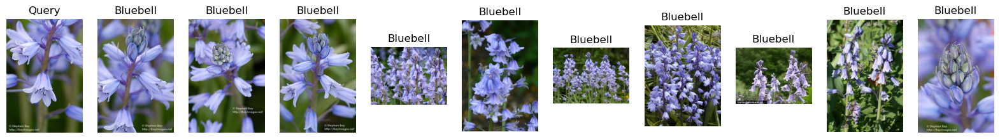

In [53]:

#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 1
especie="Bluebell"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB", n_results=10)
print(results)
show_results(query, results, species, species_path)

Como podemos ver esta primera query es un éxito ya que se puede comprobar que todas las imagenes que se han encontrado son de la misma especie de la de la query y, además, son muy similares entre si. Vamos a probar con una flor con un color menos característico:

['image_1101.jpg', 'image_0987.jpg', 'image_1053.jpg', 'image_0005.jpg', 'image_0080.jpg', 'image_0758.jpg', 'image_0996.jpg', 'image_0925.jpg', 'image_1002.jpg', 'image_0962.jpg']


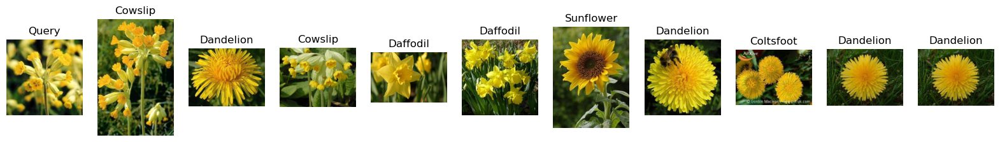

In [54]:
# QUERY 2
especie="Cowslip"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB", n_results=10)
print(results)
show_results(query, results, species, species_path)


Con esta nueva query podemos comprobar que efectivamente, al haber muchos distintos tipos de flores amarillas no acierta al encontrar todas las flores de la misma especie, pero es normal, ya que al fin y al cabo solo esta comparando los colores.

Ahora analizaremos como de bien funciona la busqueda con HOG:

['image_0973.jpg', 'image_0463.jpg', 'image_1236.jpg', 'image_0562.jpg', 'image_0538.jpg', 'image_1090.jpg', 'image_0438.jpg', 'image_0990.jpg', 'image_1093.jpg', 'image_0982.jpg']


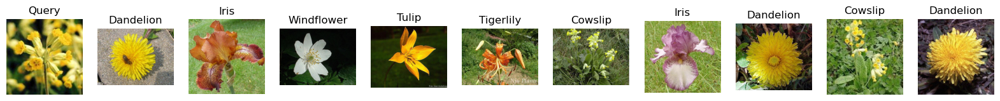

In [55]:
# QUERY 3
especie="Cowslip"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

Podemos observar que con esta flor no funciona muy bien el buscador HOG, por lo que vamos a realizar la busqueda con una flor con una forma mas característica:

['image_0463.jpg', 'image_0982.jpg', 'image_1017.jpg', 'image_0747.jpg', 'image_1236.jpg', 'image_0973.jpg', 'image_0465.jpg', 'image_0754.jpg', 'image_0854.jpg', 'image_0919.jpg']


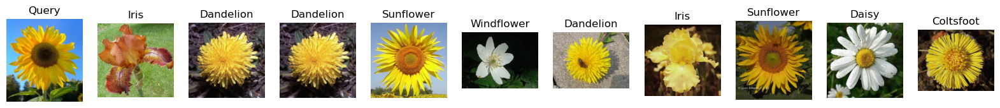

In [56]:
# QUERY 4
especie="Sunflower"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

Con esta flor se obtienen mejores resultados ya que las flores que se encuentran son muy similares entre si ya que todas tienen una forma circular con petalos al rededor.
Vamos a hacer una ultima busqueda con HOG:

['image_0398.jpg', 'image_0539.jpg', 'image_0973.jpg', 'image_1090.jpg', 'image_1083.jpg', 'image_0538.jpg', 'image_0400.jpg', 'image_0548.jpg', 'image_0902.jpg', 'image_0621.jpg']


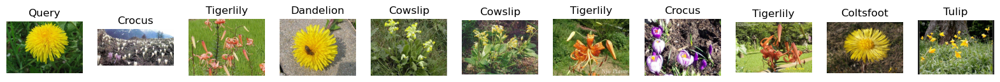

In [82]:
# QUERY 5
especie="Dandelion"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

Como podemos observar los resultados no son muy acertados.

Y finalmente la busqueda con LBP:

c:\Users\dcobo\anaconda3\Lib\site-packages\skimage\feature\texture.py:353: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


['image_1280.jpg', 'image_1082.jpg', 'image_1303.jpg', 'image_0164.jpg', 'image_0688.jpg', 'image_0133.jpg', 'image_0073.jpg', 'image_0320.jpg', 'image_0387.jpg', 'image_1191.jpg']


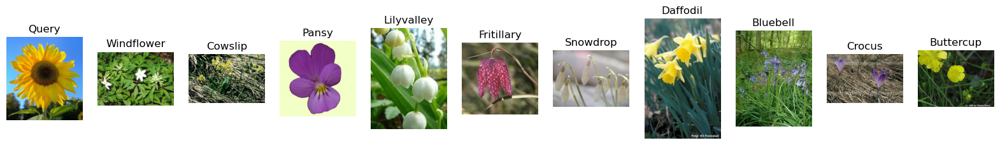

In [83]:
# QUERY 5
especie="Sunflower"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "LBP", n_results=10)
print(results)
show_results(query, results, species, species_path)

Como ya habiamos visto en el clustering, LBP no logra diferenciar muy bien las texturas de las flores

Ahora realizamos alguna busqueda con varios parámetros:

['image_0982.jpg', 'image_1017.jpg', 'image_0747.jpg', 'image_0463.jpg', 'image_1236.jpg', 'image_0973.jpg', 'image_0754.jpg', 'image_0465.jpg', 'image_0919.jpg', 'image_0990.jpg']


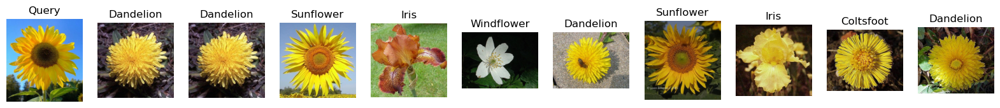

In [89]:
# QUERY 6
especie="Sunflower"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

Con el girasol tiene dificultad para realizar la busqueda ya que hay otras flores como el dandelion o el coltsfoot que tienen un color y una forma muy similar

['image_0973.jpg', 'image_1236.jpg', 'image_1093.jpg', 'image_0463.jpg', 'image_0562.jpg', 'image_0398.jpg', 'image_0606.jpg', 'image_1024.jpg', 'image_0548.jpg', 'image_0990.jpg']


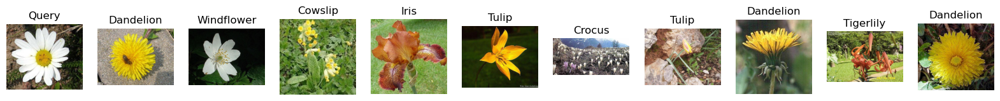

In [90]:
# QUERY 7
especie="Daisy"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_1090.jpg', 'image_1083.jpg', 'image_0398.jpg', 'image_0973.jpg', 'image_0550.jpg', 'image_1100.jpg', 'image_1034.jpg', 'image_0263.jpg', 'image_0621.jpg', 'image_0463.jpg']


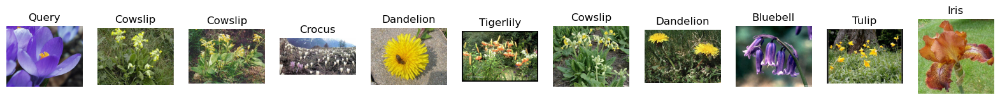

In [91]:
# QUERY 8
especie="Crocus"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0473.jpg', 'image_0973.jpg', 'image_0538.jpg', 'image_0438.jpg', 'image_1090.jpg', 'image_0463.jpg', 'image_1083.jpg', 'image_0408.jpg', 'image_0398.jpg', 'image_1236.jpg']


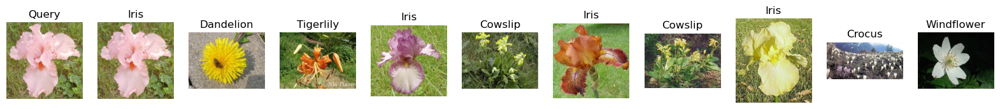

In [92]:
# QUERY 9
especie="Iris"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0973.jpg', 'image_0539.jpg', 'image_0398.jpg', 'image_0538.jpg', 'image_1066.jpg', 'image_0463.jpg', 'image_1090.jpg', 'image_0621.jpg', 'image_0548.jpg', 'image_1100.jpg']


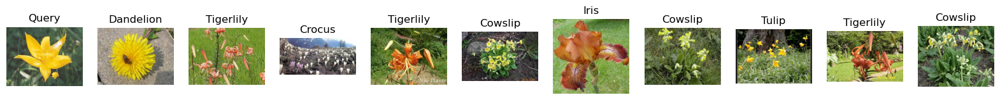

In [93]:
# QUERY 10
especie="Tulip"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0973.jpg', 'image_0562.jpg', 'image_0463.jpg', 'image_1236.jpg', 'image_0538.jpg', 'image_1090.jpg', 'image_0990.jpg', 'image_1010.jpg', 'image_0438.jpg', 'image_1093.jpg']


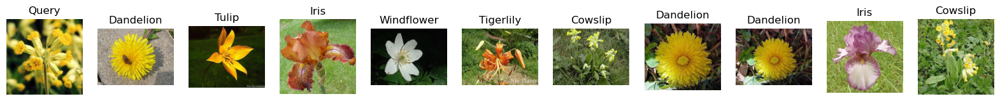

In [94]:
# QUERY 11
especie="Cowslip"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)


['image_0637.jpg', 'image_0320.jpg', 'image_1093.jpg', 'image_0562.jpg', 'image_0463.jpg', 'image_0438.jpg', 'image_1087.jpg', 'image_1236.jpg', 'image_0417.jpg', 'image_1117.jpg']


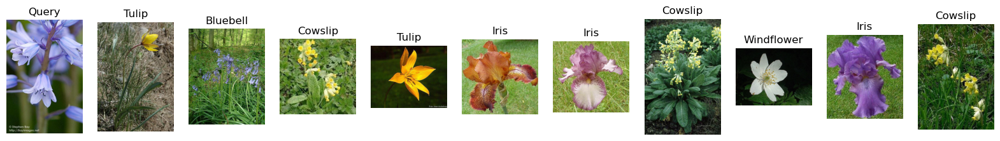

In [95]:
# QUERY 12
especie="Bluebell"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0398.jpg', 'image_0539.jpg', 'image_1090.jpg', 'image_0973.jpg', 'image_1083.jpg', 'image_0538.jpg', 'image_0400.jpg', 'image_0548.jpg', 'image_0621.jpg', 'image_0488.jpg']


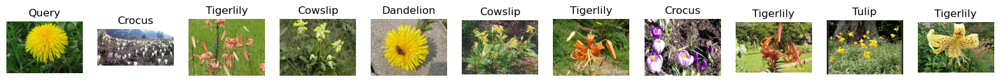

In [96]:
# QUERY 12
especie="Dandelion"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(query, db, "RGB + HOG", n_results=10)
print(results)
show_results(query, results, species, species_path)

Podemos observar que salvo en contadas ocasiones no funciona muy bien el buscador con varios parámetros.

Como concluisión podemos decir que el buscador que mejor funciona es el del histograma RGB ya que detecta los colores a la perfección
El mal funcionamiento de los otros modelos puede deberse a la mala elección de los parámetros ya que deberían funcionar también.

# 2. Generación automática de descripción FEN en tableros de ajedrez

El objetivo de este proyecto es desarrollar un sistema que sea capaz de convertir una foto de una posición de ajedrez a un formato estructurado que pueda ser comprendido por motores de ajedrez, como la notación Forsyth-Edwards (FEN), ampliamente utilizada.

La notación Forsyth-Edwards (FEN) es un método estándar para describir una posición particular en un juego de ajedrez. Es útil para registrar juegos o para configurar tableros de ajedrez en una posición específica. La notación FEN encapsula toda la información necesaria para continuar un juego desde un punto particular.

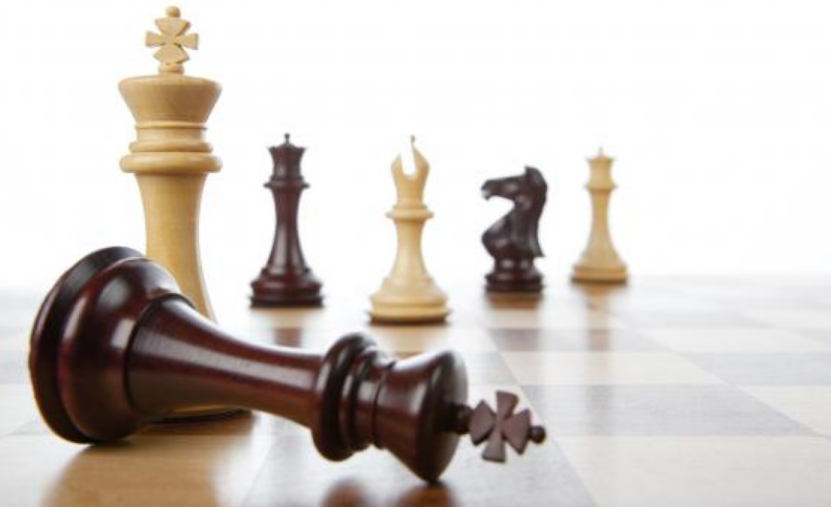

Un código FEN consta de seis campos separados por espacios. Aquí está lo que representa cada campo:

1. Posición de las Piezas: Describe la posición de las piezas en el tablero, empezando desde la octava fila (la fila más cercana al jugador negro) hasta la primera fila, con cada fila separada por '/'. Cada pieza se identifica por una letra. Las blancas usan letras mayúsculas ("K" para el rey, "Q" para la dama, "R" para las torres, "B" para los alfiles, "N" para los caballos, y "P" para los peones) y las negras usan minúsculas. Los espacios vacíos se denotan con dígitos del 1 al 8, que representan el número de casillas consecutivas vacías en esa fila.

2. Jugador Activo: Indica qué jugador mueve a continuación ("w" para las blancas, "b" para las negras).

3. Derechos de Enroque: Muestra los enroques disponibles. "K" indica que las blancas pueden hacer enroque corto, "Q" indica enroque largo de las blancas, "k" para el enroque corto de las negras y "q" para el largo. Si no hay posibilidad de enroque, se utiliza un guion ("-").

4. Al Paso: Indica si hay una oportunidad para capturar al paso. Esto se representa por la casilla en la que un peón podría ser capturado. Si no hay tal oportunidad, se utiliza un guion ("-").

5. Contador de Medio Movimiento: Este número cuenta los medios movimientos (cada movimiento de una pieza es un medio movimiento) desde la última captura o movimiento de peón. Este campo se utiliza para determinar si un juego puede ser declarado en tablas por la regla de los cincuenta movimientos.

6. Número de Movimiento: Cuenta los movimientos completos en el juego y se incrementa después de cada movimiento de las negras.

Por ejemplo, la posición inicial de un juego de ajedrez en notación FEN es:

rnbqkbnr/pppppppp/8/8/8/8/PPPPPPPP/RNBQKBNR w KQkq - 0 1

Este código FEN representa:

- La disposición estándar de las piezas al inicio del juego.
- Que las blancas (w) tienen el próximo movimiento.
- Ambos jugadores pueden enrocar de cualquier forma (KQkq).
- No hay capturas al paso posibles.
- El contador de medio movimiento es 0.
- El número de movimiento es 1.

Por ejemplo, la siguiente imagen representa una posición concreta de las piezas y su representación FEN es:

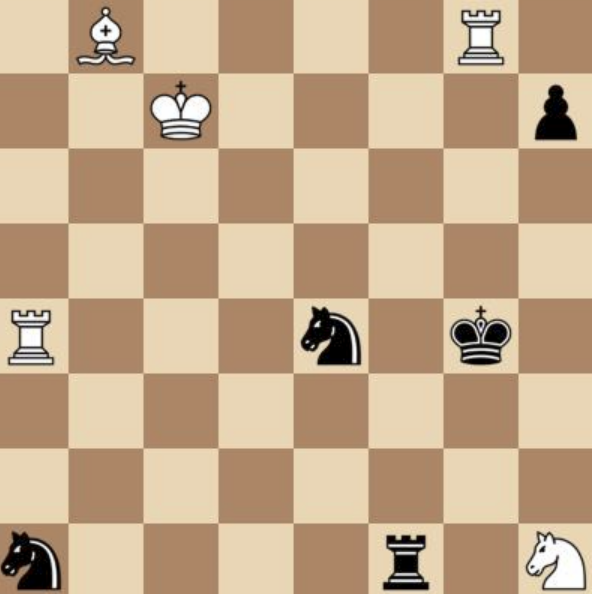![image-3.png](attachment:image-3.png)

<h1><center>1B4R1/2K4p/8/8/R3n1k1/8/8/n4r1N</center></h1>

Para esta actividad se va a obviar toda la información adicional que se codifica en esta representación y sólo nos vamos a centrar en extraer automáticamente la disposición inicial de las piezas al inicio del juego como se ha mostrado en el ejemplo anterior. Para resolver este problema vamos a utilizar lo métodos de extracción de características en imagen vistos en el curso para crear una aplicación que a partir de la imagen genere automáticamente esta notación.

Se proporcionan 5 imágenes de una disposición inicial de 5 partidas de ajedrez diferentes. Las imágenes son de tamaño 400x400. Además se proporcionan las imágenes relativas a cada una de las piezas, blancas y negras, de tamaño 50x50.

## Extracción de características
En este apartado debe aplicar las técnicas que considere oportunas sobre las diferentes piezas para extraer la información necesaria que se usará para comparar y clasificar la pieza. Tenga en cuenta que hay que diferencias no solo entre diferentes piezas sino además el color de la pieza. Extraiga los vectores de características de cada pieza y almcenelos para usarlos para la comparativa más adelante.

In [6]:
path_to_piezas = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/'

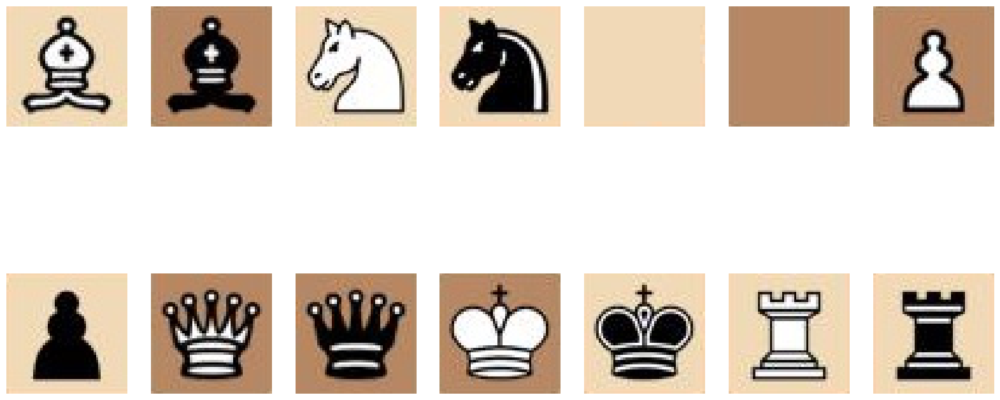

In [7]:
#vamos a visualizar todas las piezas en un unico grafico con 2 filas de 7 columnas
fig, axs = plt.subplots(2, 7, figsize=(20, 10))
for i, image_file in enumerate(os.listdir(path_to_piezas)):
    image_path = os.path.join(path_to_piezas, image_file)
    if os.path.isfile(image_path):
        row = i // 7
        col = i % 7
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        axs[row, col].imshow(image)
        axs[row, col].axis('off')
plt.show()


Comprobamos que todas las imagenes tienen el mismo tamaño:

In [107]:
#miramos el tamaño de las imagenes
for image_file in os.listdir(path_to_piezas):
    image_path = os.path.join(path_to_piezas, image_file)
    if os.path.isfile(image_path):
        image = cv2.imread(image_path)
        print(f"Image: {image_file} - Shape: {image.shape}")

Image: AlfilBlancas.jpeg - Shape: (50, 50, 3)
Image: AlfilNegras.jpeg - Shape: (50, 50, 3)
Image: CaballoBlancas.jpeg - Shape: (50, 50, 3)
Image: CaballoNegras.jpeg - Shape: (50, 50, 3)
Image: CeldaVacia1.jpeg - Shape: (50, 50, 3)
Image: CeldaVacia2.jpeg - Shape: (50, 50, 3)
Image: PeonBlancas.jpeg - Shape: (50, 50, 3)
Image: PeonNegras.jpeg - Shape: (50, 50, 3)
Image: ReinaBlancas.jpeg - Shape: (50, 50, 3)
Image: ReinaNegras.jpeg - Shape: (50, 50, 3)
Image: ReyBlancas.jpeg - Shape: (50, 50, 3)
Image: ReyNegras.jpeg - Shape: (50, 50, 3)
Image: TorreBlancas.jpeg - Shape: (50, 50, 3)
Image: TorreNegras.jpeg - Shape: (50, 50, 3)


Analizando las imagenes concluimos que para clasificar las piezas vamos a necesitar analizar el color y la forma de las piezas ya que va a ser lo que las va a distinguir del resto.
Para ello utilizaremos los vectores de HOG y RGB como hemos hecho en el apartado 1

No necesitamos reescalar ninguna imagen ya que todas son del mismo tamaño

Ya que realmente solo necesitamos diferenciar entre piezas blancas y negras vamos a utilizar las imagenes transformadas a escala de grises para poder distinguir los histogramas mucho mas facilmente:

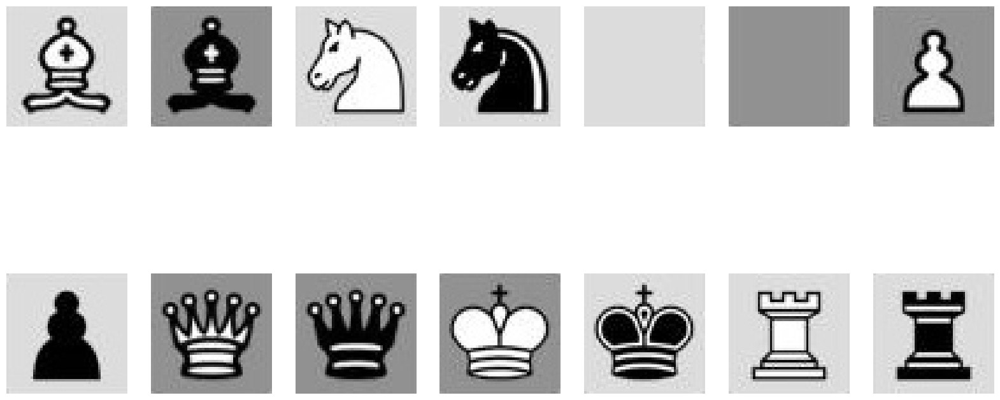

In [108]:
#Visualizamos las imagenes de las piezas en escala de grises:
fig, axs = plt.subplots(2, 7, figsize=(20, 10))
for i, image_file in enumerate(os.listdir(path_to_piezas)):
    image_path = os.path.join(path_to_piezas, image_file)
    if os.path.isfile(image_path):
        row = i // 7
        col = i % 7
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        image= np.dstack([image, image, image])
        axs[row, col].imshow(image, cmap='gray')
        axs[row, col].axis('off')

Como podemos observar de esta forma es mucho mas facil distinguir los colores.

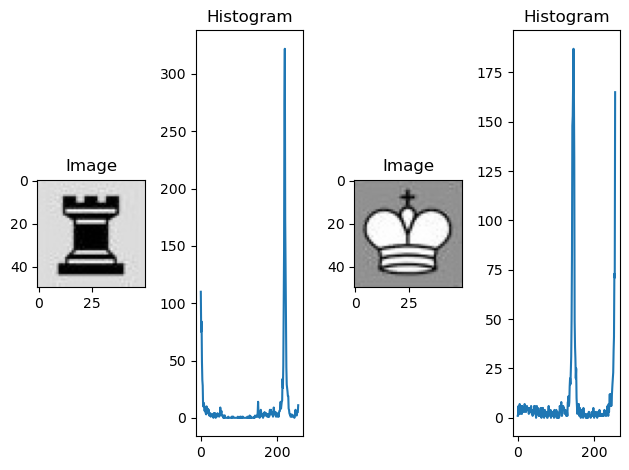

In [109]:
#Visualizamos el histograma de  color (blanco y negro) de una imagen cualquiera
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
image_bw= np.dstack([image, image, image])

hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])

# Plot the image
plt.subplot(1, 4, 1)
plt.imshow(image_bw)
plt.title('Image')

# Plot the histogram
plt.subplot(1, 4, 2)
plt.plot(hist)
plt.title('Histogram')

image = cv2.imread('./content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Piezas/ReyBlancas.jpeg', cv2.IMREAD_GRAYSCALE)
image_bw= np.dstack([image, image, image])
hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
# Plot the image
plt.subplot(1, 4, 3)
plt.imshow(image_bw)
plt.title('Image')

# Plot the histogram
plt.subplot(1, 4, 4)
plt.plot(hist)
plt.title('Histogram')

# Set the layout and display the graph
plt.tight_layout()
plt.show()



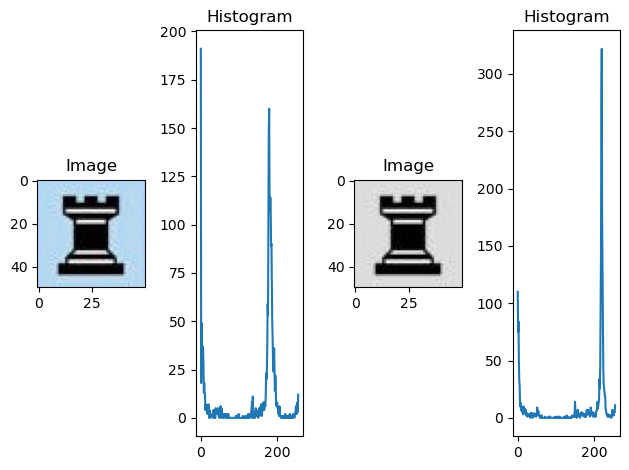

In [135]:
#Visualizamos el histograma de  color (blanco y negro) de una imagen cualquiera
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.IMREAD_GRAYSCALE)
image_bw= np.dstack([image, image, image])

hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])

# Plot the image
plt.subplot(1, 4, 1)
plt.imshow(image_bw)
plt.title('Image')

# Plot the histogram
plt.subplot(1, 4, 2)
plt.plot(hist)
plt.title('Histogram')

#Visualizamos el histograma de  color (blanco y negro) de una imagen cualquiera
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
image_bw= np.dstack([image, image, image])

hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
# Plot the image
plt.subplot(1, 4, 3)
plt.imshow(image_bw)
plt.title('Image')

# Plot the histogram
plt.subplot(1, 4, 4)
plt.plot(hist)
plt.title('Histogram')

# Set the layout and display the graph
plt.tight_layout()
plt.show()


Creamos un diccionario con el vector HOG y RGB de cada pieza, siendo el indice el nombre de cada pieza

In [10]:
rgb = RGBHistogram([8, 8, 8])
db_piezas = {}
for image_file in os.listdir(path_to_piezas):
    image_path = os.path.join(path_to_piezas, image_file)
    if os.path.isfile(image_path):
        image = cv2.imread(image_path)
        image_byn = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        image_bw= np.dstack([image_byn, image_byn, image_byn])
        fd, hog_image = hog(image_bw, orientations=9, pixels_per_cell=(7, 7), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
        hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
        db_piezas[image_file] = {"RGB": hist, "HOG": fd}

## Análisis de las características
Ahora analice en profundidad las características extraídas mediante las representaciones que considere oportunas y describa en detalle si cree que pueden ser útiles para diferenciar entre las distintas piezas. Se pide un análisis exhaustivo.

#### ANÁLISIS DEL RGB

Comenzamos dibujando el histograma de cada pieza para ver si podemos distinguir las piezas por el color:

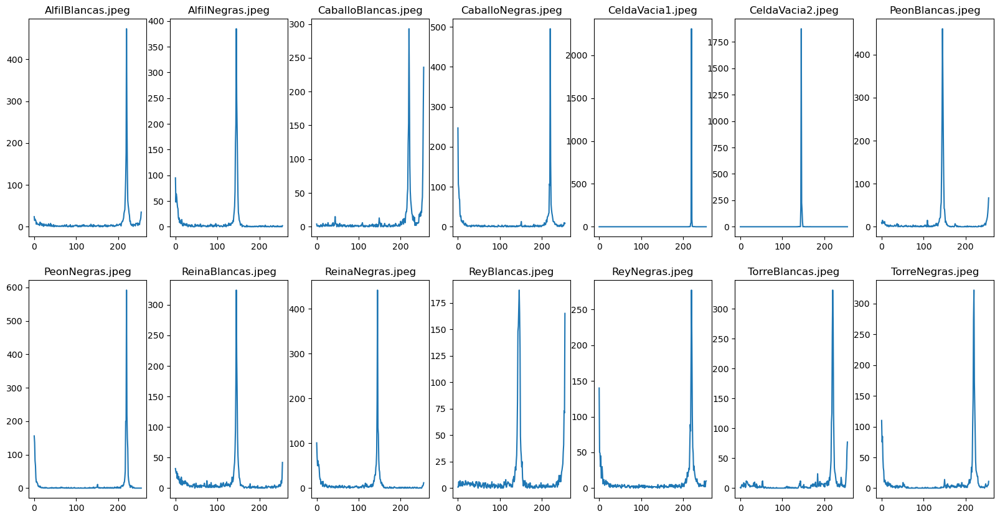

In [11]:
#Primero dibujamos el histograma RGB de cada db_pieza
fig, axs = plt.subplots(2, 7, figsize=(20, 10))
for i, image_file in enumerate(db_piezas.keys()):
    row = i // 7
    col = i % 7
    hist = db_piezas[image_file]["RGB"]
    axs[row, col].plot(hist)
    axs[row, col].set_title(image_file)

Analizando todas las gráficas podemos observar que todas tienen un maximo en un valor central. Este valor se corresponde con el color del fondo, tal y como se puede observar en los histogramas de las celdas vacias, ya que estos valores coincden con el color del fondo. 
Las piezas negras tienen un maximo local en torno al 0 y las piezas blancas en torno al 255.
Sabiendo esto, podemos clasificar las piezas en funcion al color.

In [112]:
for image_file in db_piezas.keys():
    print("Valor de la imagen: ", image_file, "en el 0 (negro) es: ", db_piezas[image_file]["RGB"][0])
    print("Valor de la imagen: ", image_file, "en el 256 (blanco) es: ", db_piezas[image_file]["RGB"][255])
    if db_piezas[image_file]["RGB"][0] > db_piezas[image_file]["RGB"][255]:
        print("La imagen ",image_file,"es negra")
    elif db_piezas[image_file]["RGB"][0] == db_piezas[image_file]["RGB"][255]:
        print("La imagen ",image_file,"es una celda vacía")
    else:
        print("La imagen",image_file,"es blanca")

Valor de la imagen:  AlfilBlancas.jpeg en el 0 (negro) es:  [24.]
Valor de la imagen:  AlfilBlancas.jpeg en el 256 (blanco) es:  [35.]
La imagen AlfilBlancas.jpeg es blanca
Valor de la imagen:  AlfilNegras.jpeg en el 0 (negro) es:  [95.]
Valor de la imagen:  AlfilNegras.jpeg en el 256 (blanco) es:  [2.]
La imagen  AlfilNegras.jpeg es negra
Valor de la imagen:  CaballoBlancas.jpeg en el 0 (negro) es:  [4.]
Valor de la imagen:  CaballoBlancas.jpeg en el 256 (blanco) es:  [236.]
La imagen CaballoBlancas.jpeg es blanca
Valor de la imagen:  CaballoNegras.jpeg en el 0 (negro) es:  [247.]
Valor de la imagen:  CaballoNegras.jpeg en el 256 (blanco) es:  [9.]
La imagen  CaballoNegras.jpeg es negra
Valor de la imagen:  CeldaVacia1.jpeg en el 0 (negro) es:  [0.]
Valor de la imagen:  CeldaVacia1.jpeg en el 256 (blanco) es:  [0.]
La imagen  CeldaVacia1.jpeg es una celda vacía
Valor de la imagen:  CeldaVacia2.jpeg en el 0 (negro) es:  [0.]
Valor de la imagen:  CeldaVacia2.jpeg en el 256 (blanco) es: 

Como podemos ver en la ejecución de arriba este metodo sirve perfefctamente para distinguir si las piezas son blancas, negras o celdas vacias.

In [113]:
blancas=[]
negras = []
tablero = []
for image_file in db_piezas.keys():
    if db_piezas[image_file]["RGB"][0] > db_piezas[image_file]["RGB"][255]:
        negras.append(image_file)
    elif db_piezas[image_file]["RGB"][0] == db_piezas[image_file]["RGB"][255]:
        tablero.append(image_file)
    else:
        blancas.append(image_file)

In [114]:
negras

['AlfilNegras.jpeg',
 'CaballoNegras.jpeg',
 'PeonNegras.jpeg',
 'ReinaNegras.jpeg',
 'ReyNegras.jpeg',
 'TorreNegras.jpeg']

In [115]:
blancas

['AlfilBlancas.jpeg',
 'CaballoBlancas.jpeg',
 'PeonBlancas.jpeg',
 'ReinaBlancas.jpeg',
 'ReyBlancas.jpeg',
 'TorreBlancas.jpeg']

In [116]:
tablero

['CeldaVacia1.jpeg', 'CeldaVacia2.jpeg']

Ahora crearemos una función que nos sirva para clasificar cualquier ficha según el color:

In [12]:

def color(pieza):
    image_byn = cv2.cvtColor(pieza, cv2.COLOR_BGR2GRAY)
    image_bw= np.dstack([image_byn, image_byn, image_byn])
    hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
    if hist[0] > hist[255]:
        return "Negro"
    elif hist[0] == hist[255]:
        return "Tablero"
    else:
        return "Blanco"


In [143]:
for image_file in db_piezas.keys():
    image_path = os.path.join(path_to_piezas, image_file)
    query = cv2.imread(image_path)
    print("La imagen ", image_file, "es de color: ", color(query))
   
   

La imagen  AlfilBlancas.jpeg es de color:  Blanca
La imagen  AlfilNegras.jpeg es de color:  Negra
La imagen  CaballoBlancas.jpeg es de color:  Blanca
La imagen  CaballoNegras.jpeg es de color:  Negra
La imagen  CeldaVacia1.jpeg es de color:  Tablero
La imagen  CeldaVacia2.jpeg es de color:  Tablero
La imagen  PeonBlancas.jpeg es de color:  Blanca
La imagen  PeonNegras.jpeg es de color:  Negra
La imagen  ReinaBlancas.jpeg es de color:  Blanca
La imagen  ReinaNegras.jpeg es de color:  Negra
La imagen  ReyBlancas.jpeg es de color:  Blanca
La imagen  ReyNegras.jpeg es de color:  Negra
La imagen  TorreBlancas.jpeg es de color:  Blanca
La imagen  TorreNegras.jpeg es de color:  Negra


#### ANÁLISIS DEL HOG

Comenzamos dibujando la imagen HOG de cada pieza para ver si podemos distinguir las piezas por la forma:

Hemos utilizado las imagenes en blanco y negro tambien porque el color no es relevante y nos ayuda a reducir ruido

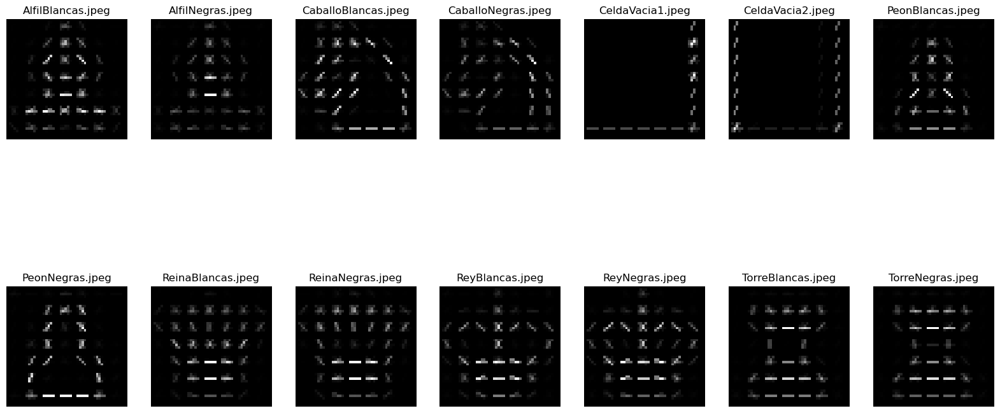

In [144]:
fig, axs = plt.subplots(2, 7, figsize=(20, 10))
for i, image_file in enumerate(db_piezas.keys()):
    row = i // 7
    col = i % 7
    image_path = os.path.join(path_to_piezas, image_file)
    image = cv2.imread(image_path,cv2.IMREAD_GRAYSCALE)
    image= np.dstack([image, image, image])
    fd, hog_image = hog(image, orientations=9, pixels_per_cell=(7, 7), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
    axs[row, col].imshow(hog_image, cmap=plt.cm.gray)
    axs[row, col].axis('off')
    axs[row, col].set_title(image_file)

Con esta representación podemos observar que efectivamente si que se logran identificar los patrones facilmente.

Ahora vamos a hacer algunas comprobaciones para ver si con estos vectores se puede conseguir identificar las imagenes:

De forma similar al apartado 1 vamos a ver para cada ficha cuales son las 2 fichas que mas se parecen del diccionario que hemos creado segun el histograma HOG, utilizando la distancia euclidea entre el vector HOG de la imagen Query y las del diccionario. El resultado debería ser la propia ficha y su correspondiente en el otro color:

In [13]:
def search(query, db, n_results=2):
    results = {}
    for key in db.keys():
        image_byn = cv2.cvtColor(query, cv2.IMREAD_GRAYSCALE)
        image_bw= np.dstack([image_byn, image_byn, image_byn])
        fd, hog_image = hog(image_bw, orientations=9, pixels_per_cell=(7, 7), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
        d = np.linalg.norm(db[key]["HOG"]-fd)
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    return list(results.keys())[:n_results]

Ahora comprobamos el funcionamiento para todas las imagenes del diccionario:

In [146]:

for image_file in db_piezas.keys():
    image_path = os.path.join(path_to_piezas, image_file)
    query = cv2.imread(image_path)
    results = search(query, db_piezas, n_results=2)
    print("La imagen ", image_file, "es de color: ", color(query), "y las imagenes más parecidas son: ", results)

La imagen  AlfilBlancas.jpeg es de color:  Blanca y las imagenes más parecidas son:  ['AlfilBlancas.jpeg', 'AlfilNegras.jpeg']
La imagen  AlfilNegras.jpeg es de color:  Negra y las imagenes más parecidas son:  ['AlfilNegras.jpeg', 'AlfilBlancas.jpeg']
La imagen  CaballoBlancas.jpeg es de color:  Blanca y las imagenes más parecidas son:  ['CaballoBlancas.jpeg', 'CaballoNegras.jpeg']
La imagen  CaballoNegras.jpeg es de color:  Negra y las imagenes más parecidas son:  ['CaballoNegras.jpeg', 'CaballoBlancas.jpeg']
La imagen  CeldaVacia1.jpeg es de color:  Tablero y las imagenes más parecidas son:  ['CeldaVacia1.jpeg', 'CeldaVacia2.jpeg']
La imagen  CeldaVacia2.jpeg es de color:  Tablero y las imagenes más parecidas son:  ['CeldaVacia2.jpeg', 'CeldaVacia1.jpeg']
La imagen  PeonBlancas.jpeg es de color:  Blanca y las imagenes más parecidas son:  ['PeonBlancas.jpeg', 'PeonNegras.jpeg']
La imagen  PeonNegras.jpeg es de color:  Negra y las imagenes más parecidas son:  ['PeonNegras.jpeg', 'PeonB

Podemos comprobar que las funciones que hemos creado clasifican a la perfección las imagenes del dataset. 
Habrá que ver si con otros modelos de piezas funcionan igual de bien, pero eso lo veremos mas adelante

Modificamos la función anterior para que en vez de devolver el nombre de la imagen simplemente devuelva el nombre de la pieza:

In [14]:
#hacer una funcion muy similar a search solo que ahora devuelva el nombre de la ficha que mas se parece ej: "ReyBlancas.jpeg" -> "Rey"
def search2(query):
    results = {}
    for key in db_piezas.keys():
        image_byn = cv2.cvtColor(query, cv2.IMREAD_GRAYSCALE)
        image_bw= np.dstack([image_byn, image_byn, image_byn])
        fd, hog_image = hog(image_bw, orientations=9, pixels_per_cell=(7, 7), cells_per_block=(2, 2), visualize=True, channel_axis=-1)
        d = np.linalg.norm(db_piezas[key]["HOG"]-fd)
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    resultado= list(results.keys())[0]
    if "Blancas.jpeg" in resultado:
        return resultado.split("Blancas")[0]
    elif "Negras.jpeg" in resultado:
        return resultado.split("Negras")[0]
    else:
        return "Celda Vacía"
   

## Ventana deslizante, extracción de caracteríticas y clasificación de la pieza
Este es el apartado dónde se desarrollará el grueso del programa completo. Dado que estamos haciendo una detección de objetos, emplearemos, al igual que vimos en ejemplos del laboratorio, una ventana deslizante para recorrer la imagen y clasificar la parte extraída mediante la ventana. Nota: Tenga en cuenta que las imágenes son de 400x400 píxeles y que cada casilla del tablero ocupa por tanto 50x50 píxeles.

Una vez extraído el contenido de la ventana se aplicarán los mismos descriptores de características empleados en apartados anteriores para con ellos clasificar la pieza.

Finalmente, debe realizar una comparación con los vectores de características que almacenó previamente para clasificar el tipo de pieza y si es del jugador de las blancas o de las negras. Para esta comparativa puede usar una simple mñetrica de distancia como la distancia euclídea, distancia del coseno, entre otras.

Definimos el path de las imagenes de los tableros:

In [16]:
path_tableros='./content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Tableros/'

Primero crearemos la función de las ventanas deslizantes:

In [17]:
import numpy as np

def sliding_window(image, window_size, stride):
    height, width = image.shape[:2]
    windows = []
    
    for y in range(0, height - window_size[0] + 1, stride):
        for x in range(0, width - window_size[1] + 1, stride):
            window = image[y:y+window_size[0], x:x+window_size[1]]
            windows.append(window)
    
    return windows



Aplicamos la funcion de la ventana al primer tablero para ver si funciona:

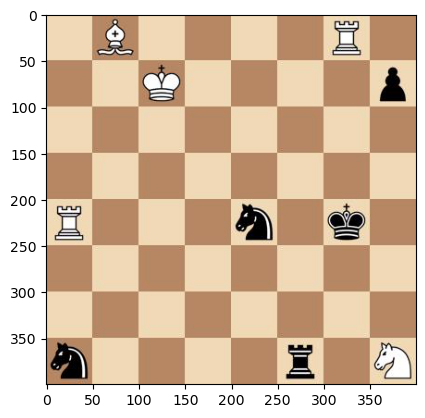

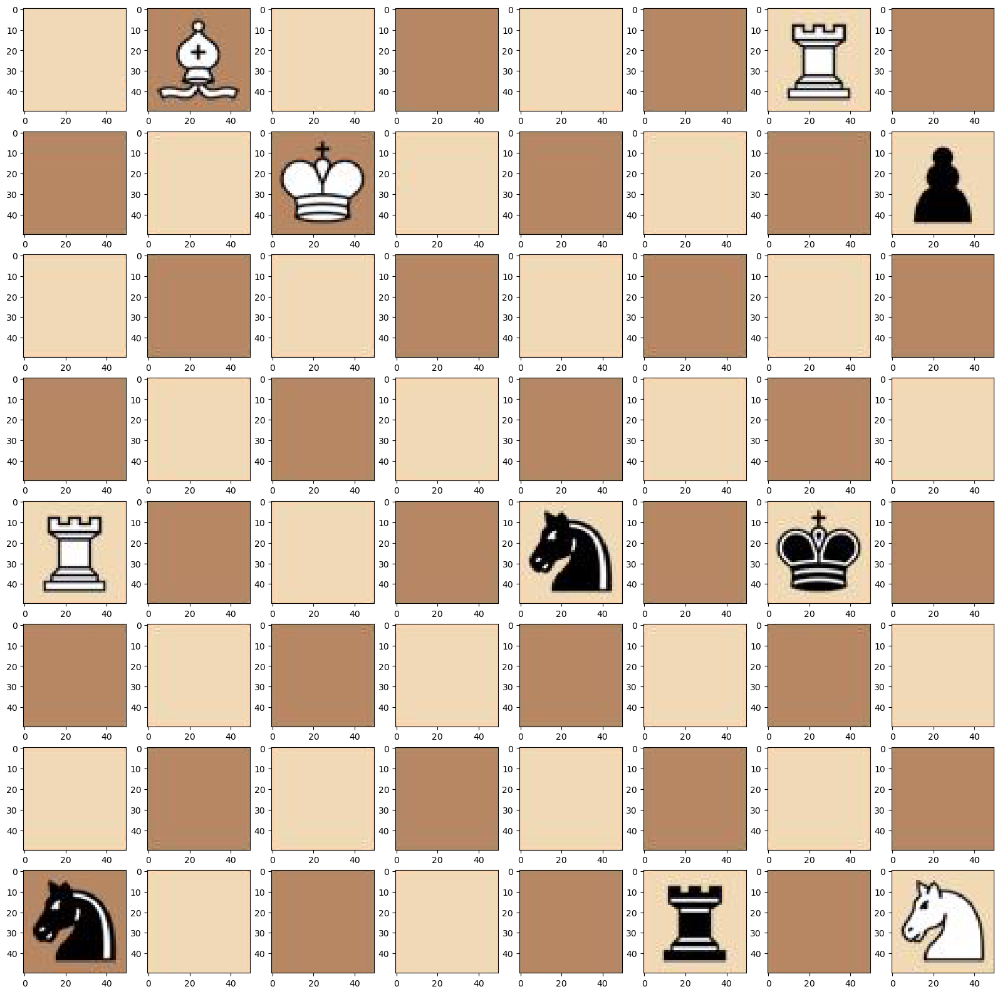

In [173]:
#Aplicamos la funcion de la ventana al primer tablero para ver si funciona:
image_path = os.path.join(path_tableros, "1B4R1-2K4p-8-8-R3n1k1-8-8-n4r1N.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    axs[row, col].imshow(window)
    
plt.show()

Como podemos observar el codigo es capaz de extraer del tablero las casillas. Ahora vamos a aplicar las funciones de clasificación que hemos creado anteriormente para ver si detecta las piezas correctamente:

#Recorremos el tablero 1 y aplicamos las funciones de detección 
#Despues dibujaremos el resultado en un grid de 8x8 en el que el indice de cada imagen será el tipo de ficha (la imagen mas similar del diccionario) y su color

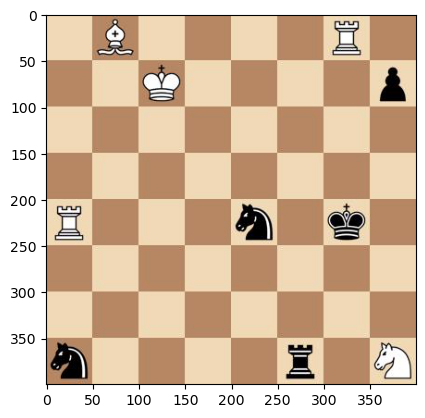

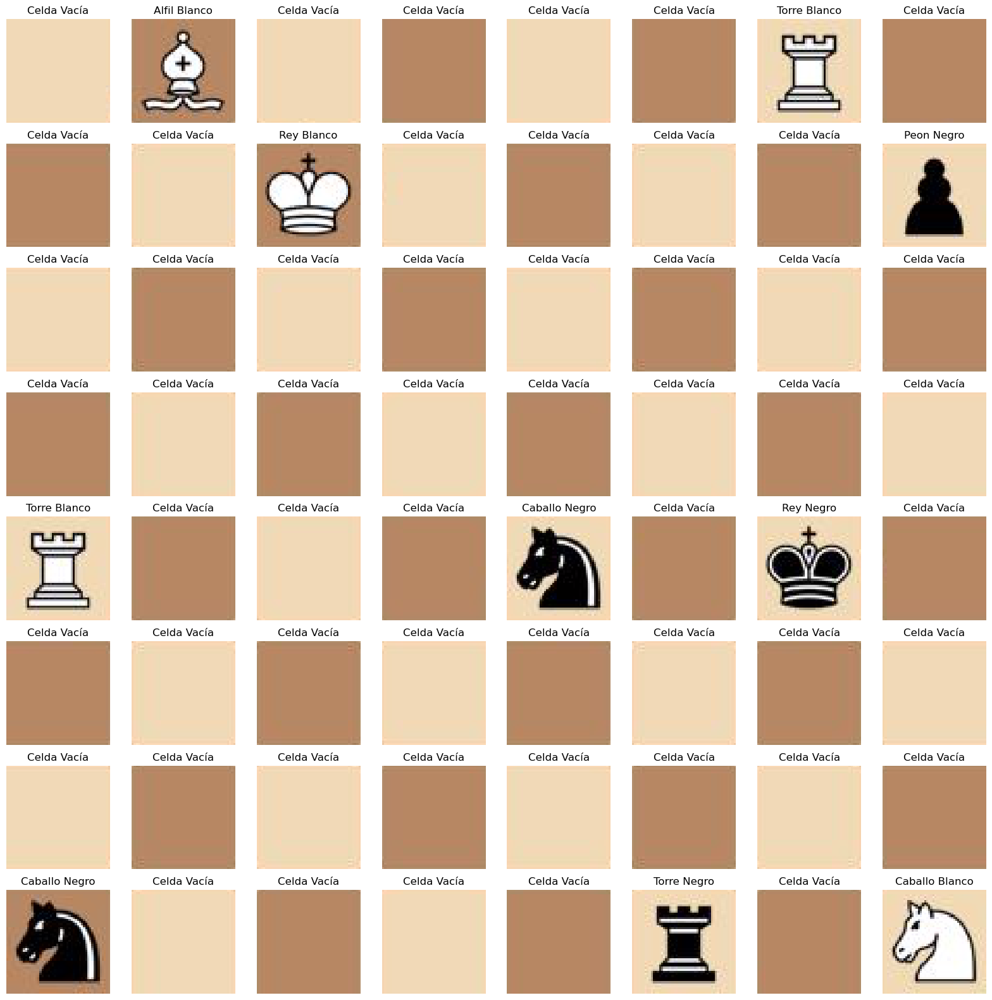

In [176]:
#Primero cargamos el tablero 1
image_path = os.path.join(path_tableros, "1B4R1-2K4p-8-8-R3n1k1-8-8-n4r1N.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color(window))
        axs[row, col].axis('off')


Podemos comprobar en la imagen de arriba que clasifica correctamente todas las piezas del tablero 1.

## Extracción final del código FEN para la imagen de entrada
Mediante las detecciones realizadas, convierta ahora esa información en la codificación FEN descrita al inicio del ejercicio:

Posición de las Piezas: Describe la posición de las piezas en el tablero, empezando desde la octava fila (la fila más cercana al jugador negro) hasta la primera fila, con cada fila separada por '/'. Cada pieza se identifica por una letra. Las blancas usan letras mayúsculas ("K" para el rey, "Q" para la dama, "R" para las torres, "B" para los alfiles, "N" para los caballos, y "P" para los peones) y las negras usan minúsculas. Los espacios vacíos se denotan con dígitos del 1 al 8, que representan el número de casillas consecutivas vacías en esa fila.


In [19]:
#Mediante las detecciones realizadas, convierta ahora esa información en la codificación FEN descrita al inicio del ejercicio.
def FEN(image):
    windows = sliding_window(image, (50, 50), 50)
    FEN = ""
    contador=0
    #empezando por la ultima ventana, identifica la pieza 
    for i, window in enumerate(windows[::-1]):
        results = search2(window)
        if results == "Celda Vacía":
            if (i+1) % 8 == 0:
                FEN += str(contador+1)
                contador = 0
                FEN += "/"
            else:
                contador += 1
        else:
            if(contador != 0):
                FEN += str(contador)
                contador = 0
            if results == "Rey" and color(window) == "Blanco":
                FEN += "K"
            elif results == "Rey" and color(window) =="Negro":
                FEN+="k"
            elif results == "Reina" and color(window) == "Blanco":
                FEN += "Q"
            elif results == "Reina" and color(window) =="Negro":
                FEN+="q"
            elif results == "Torre" and color(window) == "Blanco":
                FEN += "R"
            elif results == "Torre" and color(window) =="Negro":
                FEN+="r"
            elif results == "Alfil" and color(window) == "Blanco":
                FEN += "B"
            elif results == "Alfil" and color(window) =="Negro":
                FEN+="b"
            elif results == "Peon" and color(window) == "Blanco":
                FEN += "P"
            elif results == "Peon" and color(window) =="Negro":
                FEN+="p"
            elif results == "Caballo" and color(window) == "Blanco":
                FEN += "N"
            elif results == "Caballo" and color(window) =="Negro":
                FEN+="n"
            if (i+1) % 8 == 0:
                if(results=="Celda Vacía"):
                    FEN += str(contador)
                    contador = 0
                FEN += "/"
           
    return(FEN)
                

Comprobamos si funciona con el primer tablero

N1r4n/8/8/1k1n3R/8/8/p4K2/1R4B1/


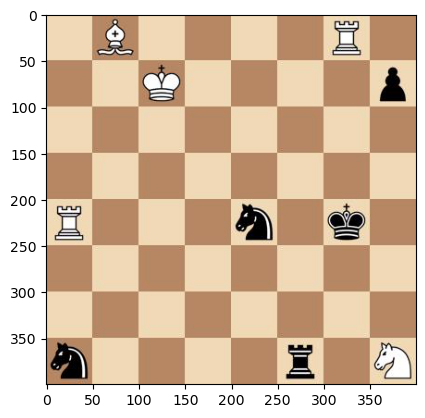

In [216]:
#Primero cargamos el tablero 1
image_path = os.path.join(path_tableros, "1B4R1-2K4p-8-8-R3n1k1-8-8-n4r1N.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
print(FEN(image))

Podemos ver que para el tablero 1 se crea el código FEN correctamenre

## Análisis de errores
Aplique su solución a las 5 imágenes que se proporcionan. Las piezas no son totalmente iguales en todas ellas pero si muy parecidas. Analice si ocurre algún error o errores, grafique todo lo que considere necesario y describa en detalle por qué puede estar sucediendo y que podría hacerse para solucionarlos.

#### IMAGEN 2

b7/6b1/R3k2P/8/7q/6P1/5K2/6B1/


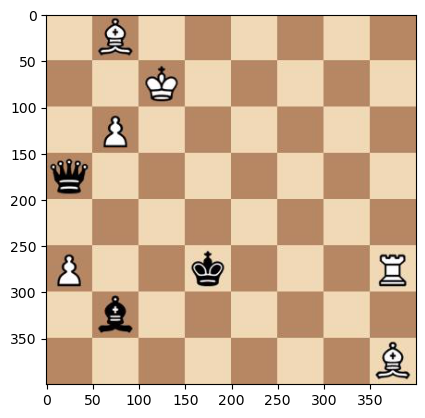

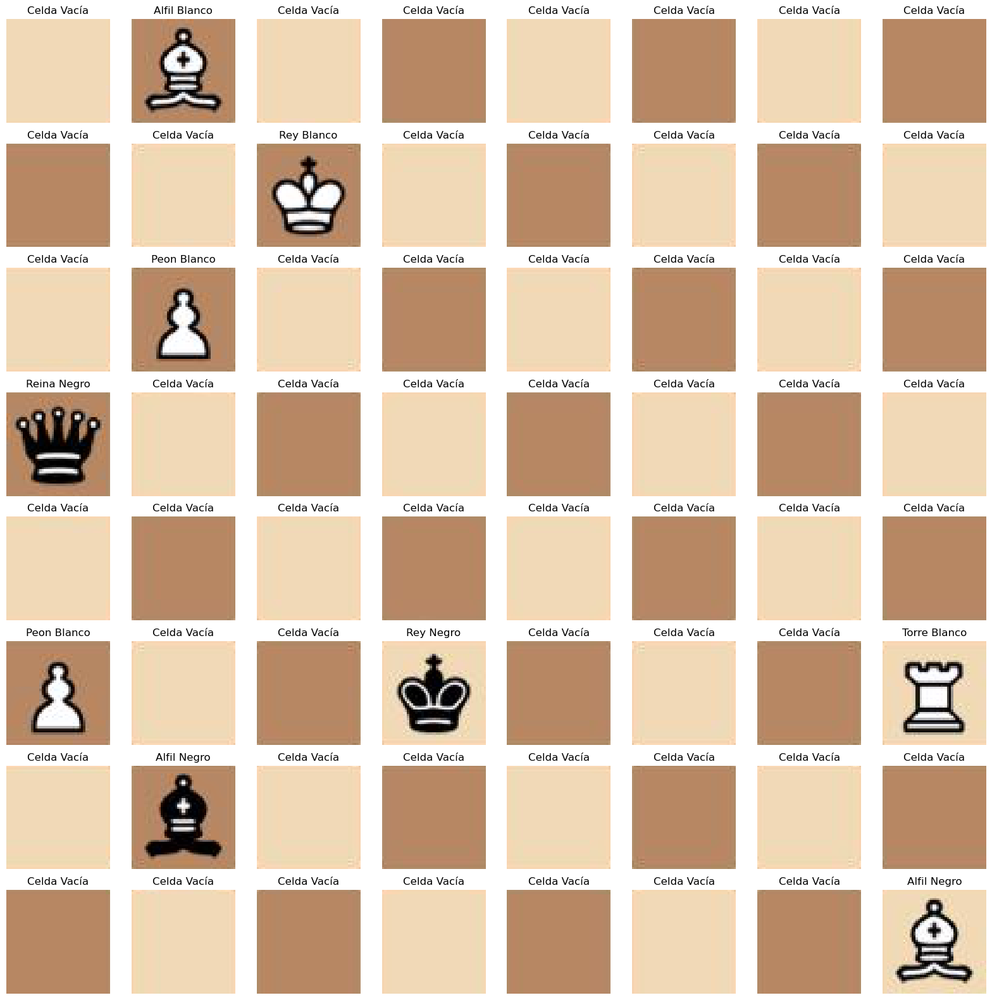

In [231]:
#Primero cargamos el tablero 2
image_path = os.path.join(path_tableros, "1B6-2K5-1P6-q7-8-P2k3R-1b6-7B.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color(window))
        axs[row, col].axis('off')
print(FEN(image))

En el tablero 2 realiza todo correctamente salvo una pieza que es el alfil blanco de abajo a la derecha que lo detecta como si fuese un alfil negro.

Esto podria deberse a algun fallo en el histograma RGB, ya que puede que la pieza no sea de un blanco perfecto y por lo tanto el algoritmo detecta que hay mas negro y por lo tanto lo detecta como negro:

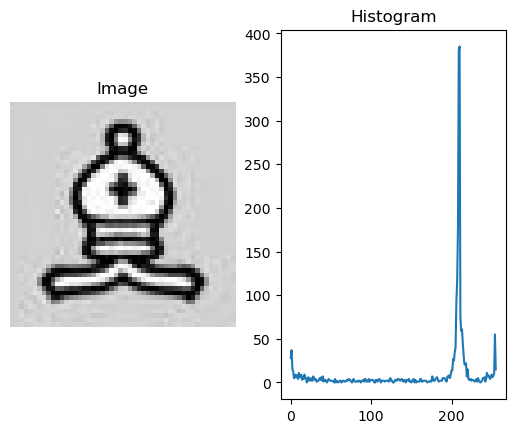

In [244]:
imagen=window[::]
#dibujar el histograma de color de la imagen y al lado  la imagen
image_byn = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
image_bw= np.dstack([image_byn, image_byn, image_byn])
hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
# Plot the image
plt.subplot(1, 2, 1)
plt.imshow(image_bw)
plt.title('Image')
plt.axis('off')
# Plot the histogram
plt.subplot(1, 2, 2)
plt.plot(hist)
plt.title('Histogram')
plt.show()



Como podemos observar, en el histograma hay una subida del 253 al 254 pero del 254 al 255 baja:

In [245]:
print(hist[0])
print(hist[255])
print(hist[254])
print(hist[253])

[28.]
[15.]
[55.]
[10.]


De esta forma, el algoritmo detecta que el valor del negro (28) es superior al del blanco puro (10) y por eso detecta que la pieza es negra.

Esto tiene una muy facil solucion que es, en vez de coger unicamente los valores extremos de blanco y negro, coger intervalos mas amplios en la funcion de color()

#### IMAGEN 3

3b1N2/5R2/b7/k7/7K/1B6/4P3/6b1/


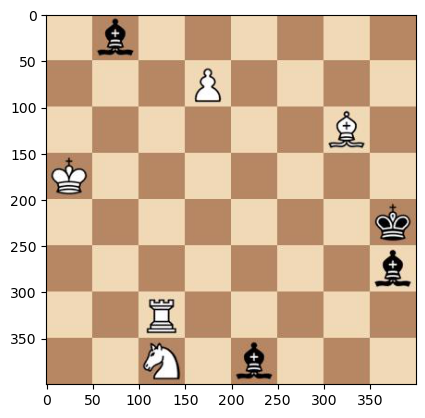

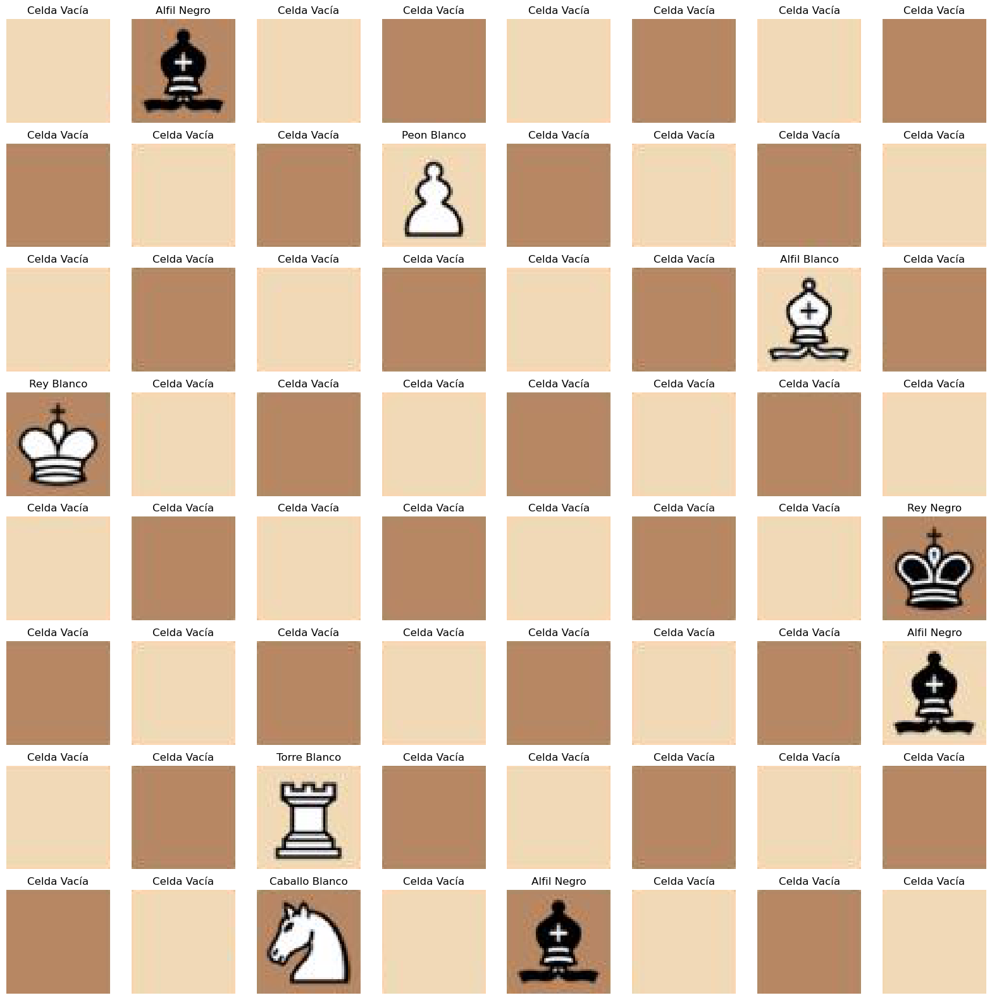

In [224]:
#Primero cargamos el tablero 3
image_path = os.path.join(path_tableros, "1b6-3P4-6B1-K7-7k-7b-2R5-2N1b3.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color(window))
        axs[row, col].axis('off')
print(FEN(image))

Este tablero lo identifica a la perfección 

#### IMAGEN 4

2b5/1q6/1B6/4k3/8/6Rr/4B3/6K1/


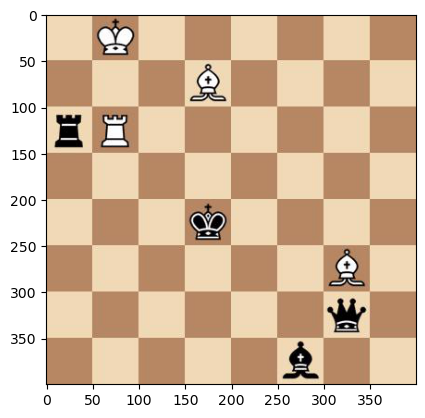

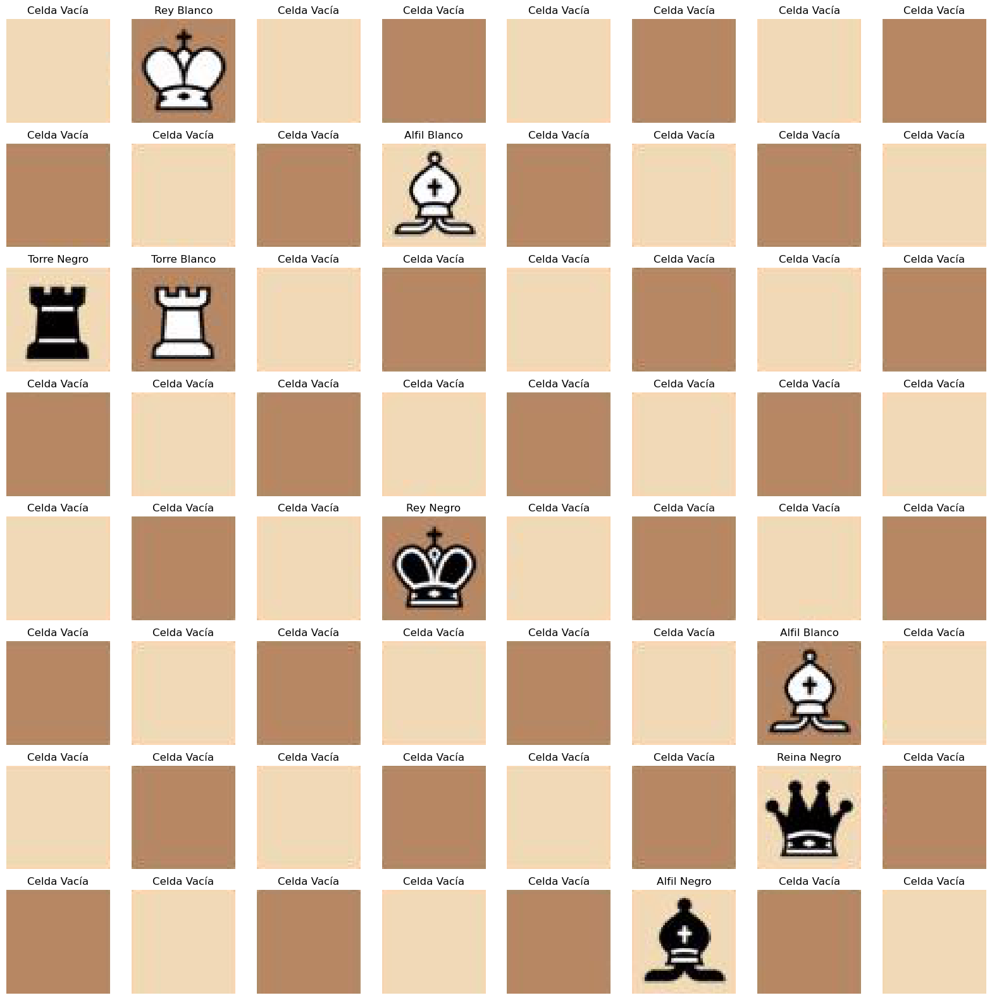

In [225]:
#Primero cargamos el tablero 4
image_path = os.path.join(path_tableros, "1K6-3B4-rR6-8-3k4-6B1-6q1-5b2.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color(window))
        axs[row, col].axis('off')
print(FEN(image))

Este tablero también lo identifica perfectamente

#### IMAGEN 5

13kb1/43/8/6/p3q1/4n3/41/61/


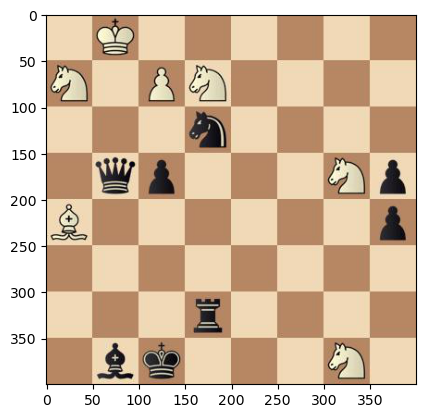

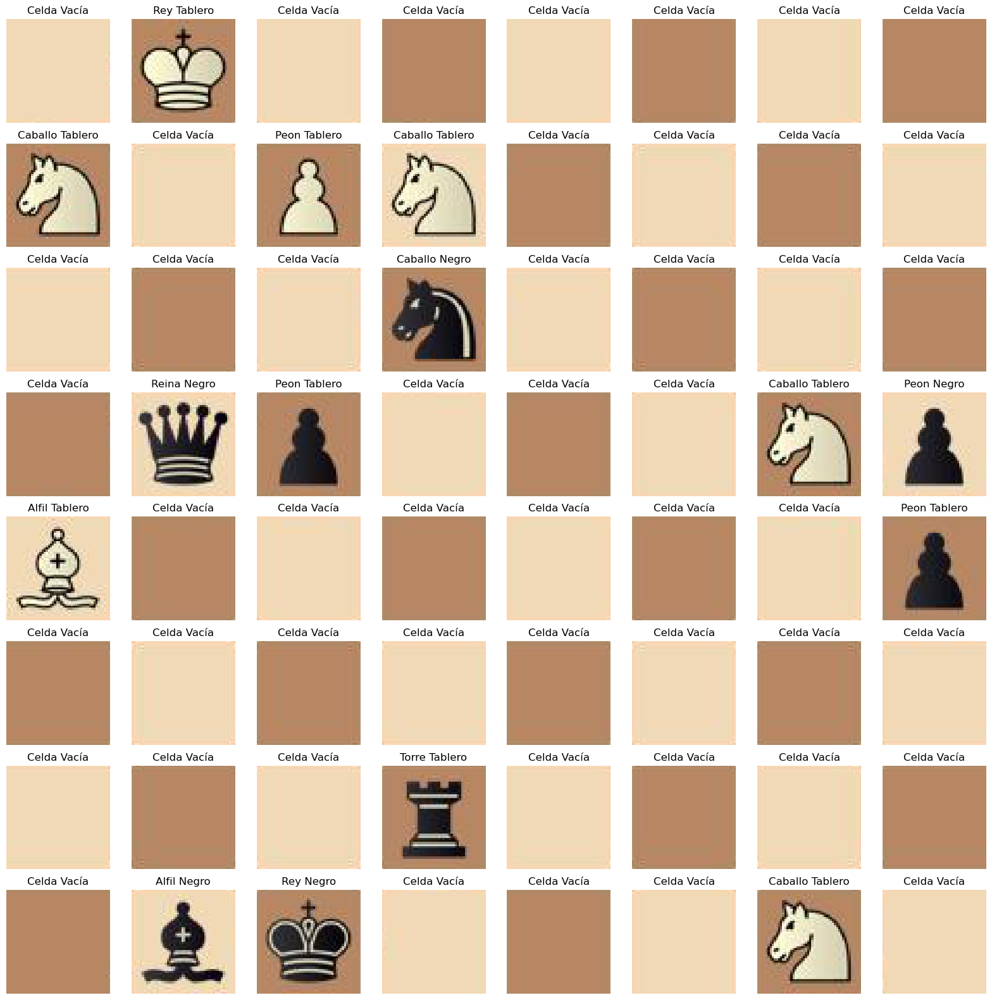

In [26]:
#Primero cargamos el tablero 5
image_path = os.path.join(path_tableros, "1K6-N1PN4-3n4-1qp3Np-B6p-8-3r4-1bk3N1.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color(window))
        axs[row, col].axis('off')
print(FEN(image))

En este tablero el fallo se visualiza a simple vista y es que las fichas blancas no son blancas si no que amarillas.
Esto se puede solucionar también con lo comentado en el tablero 2

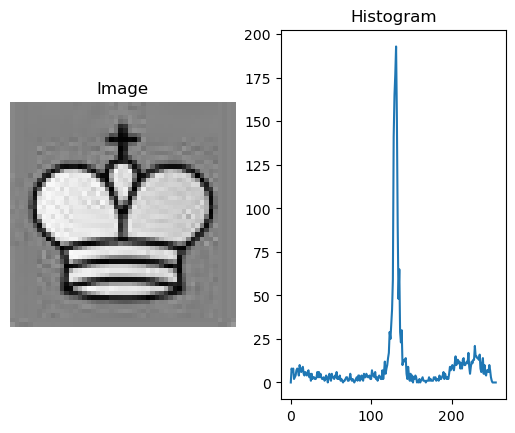

In [28]:
imagen=windows[1]
#dibujar el histograma de color de la imagen y al lado  la imagen
image_byn = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
image_bw= np.dstack([image_byn, image_byn, image_byn])
hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
# Plot the image
plt.subplot(1, 2, 1)
plt.imshow(image_bw)
plt.title('Image')
plt.axis('off')
# Plot the histogram
plt.subplot(1, 2, 2)
plt.plot(hist)
plt.title('Histogram')
plt.show()

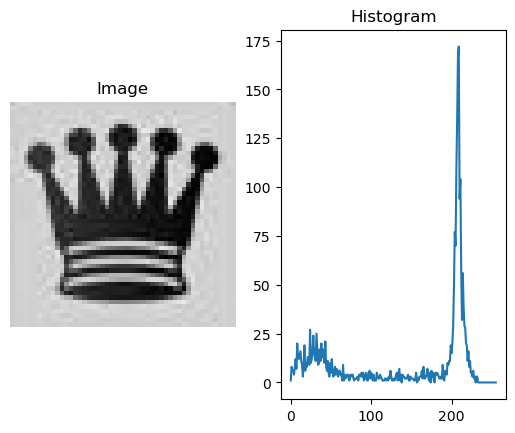

In [32]:
imagen=windows[25]
#dibujar el histograma de color de la imagen y al lado  la imagen
image_byn = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
image_bw= np.dstack([image_byn, image_byn, image_byn])
hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
# Plot the image
plt.subplot(1, 2, 1)
plt.imshow(image_bw)
plt.title('Image')
plt.axis('off')
# Plot the histogram
plt.subplot(1, 2, 2)
plt.plot(hist)
plt.title('Histogram')
plt.show()

Viendo los histogramas podemos ver que efectivamente debemos ampliar los margenes de la función color

#### IMAGEN 6

1NR5/2pq2N1/6K1/Q7/5kn1/5P2/7P/4n1Q1/


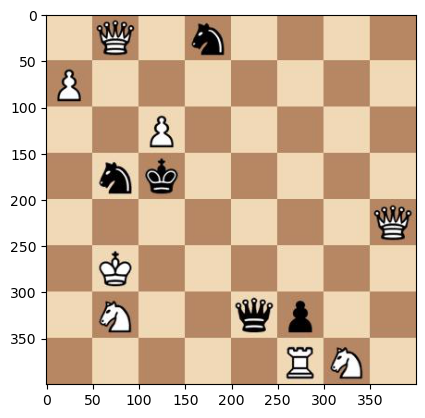

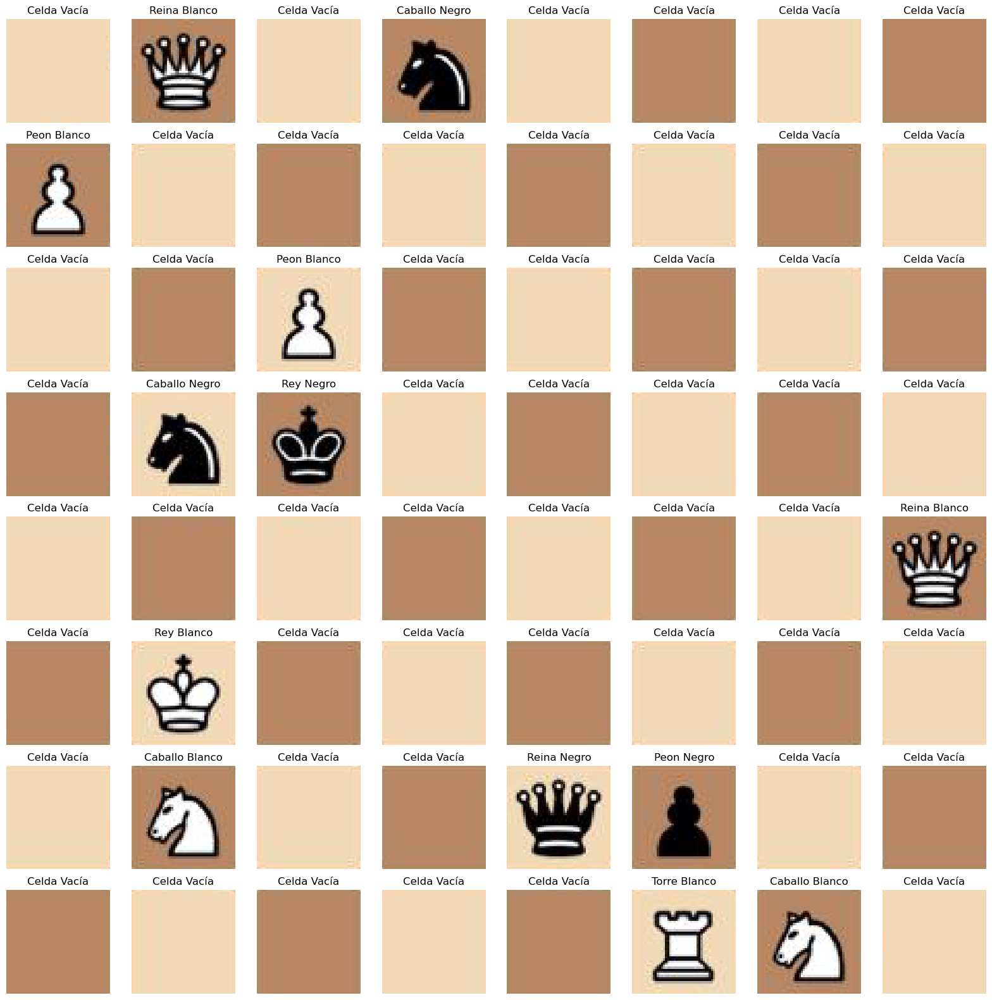

In [227]:
#Primero cargamos el tablero 6
image_path = os.path.join(path_tableros, "1Q1n4-P7-2P5-1nk5-7Q-1K6-1N2qp2-5RN1.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color(window))
        axs[row, col].axis('off')
print(FEN(image))

Este tablero también lo identifica perfectamente

### NUEVA SOLUCIÓN:

Definimos la nueva funcion color:

Como hemos comentado antes debemos cambiar el metodo de seleccion del color. Ahora probaremos cogiendo el valor máximo de los histogramas en rangos definidos. Si el valor maximo se encuentra en el intervalo del negro sera negra la pieza y si no, blanca.

In [103]:
def color2(pieza):
    image_byn = cv2.cvtColor(pieza, cv2.COLOR_BGR2GRAY)
    image_bw= np.dstack([image_byn, image_byn, image_byn])
    hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
    negro = np.max(hist[0:25])
    blanco = np.max(hist[230:255])
    if negro > blanco :
        return "Negro"
    elif negro < blanco:
        return "Blanco"
    else:
        return "Tablero"

La funcion FEN dependia de color por lo que tenemos que cambiarla tambien:

In [104]:
def FEN(image):
    windows = sliding_window(image, (50, 50), 50)
    FEN = ""
    contador=0
    #empezando por la ultima ventana, identifica la pieza 
    for i, window in enumerate(windows[::-1]):
        results = search2(window)
        if results == "Celda Vacía":
            if (i+1) % 8 == 0:
                FEN += str(contador+1)
                contador = 0
                FEN += "/"
            else:
                contador += 1
        else:
            if(contador != 0):
                FEN += str(contador)
                contador = 0
            if results == "Rey" and color2(window) == "Blanco":
                FEN += "K"
            elif results == "Rey" and color2(window) =="Negro":
                FEN+="k"
            elif results == "Reina" and color2(window) == "Blanco":
                FEN += "Q"
            elif results == "Reina" and color2(window) =="Negro":
                FEN+="q"
            elif results == "Torre" and color2(window) == "Blanco":
                FEN += "R"
            elif results == "Torre" and color2(window) =="Negro":
                FEN+="r"
            elif results == "Alfil" and color2(window) == "Blanco":
                FEN += "B"
            elif results == "Alfil" and color2(window) =="Negro":
                FEN+="b"
            elif results == "Peon" and color2(window) == "Blanco":
                FEN += "P"
            elif results == "Peon" and color2(window) =="Negro":
                FEN+="p"
            elif results == "Caballo" and color2(window) == "Blanco":
                FEN += "N"
            elif results == "Caballo" and color2(window) =="Negro":
                FEN+="n"
            if (i+1) % 8 == 0:
                if(results=="Celda Vacía"):
                    FEN += str(contador)
                    contador = 0
                FEN += "/"
           
    return(FEN)

Miramos el analisis de los tableros que fallaron con la nueva funcion:


#### TABLERO 5

1N3kb1/4r3/8/p6B/pN3pq1/4n3/4NP1N/6K1/


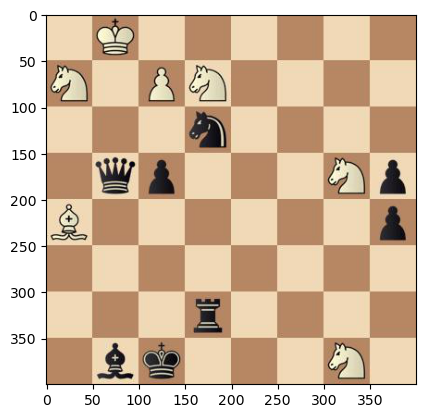

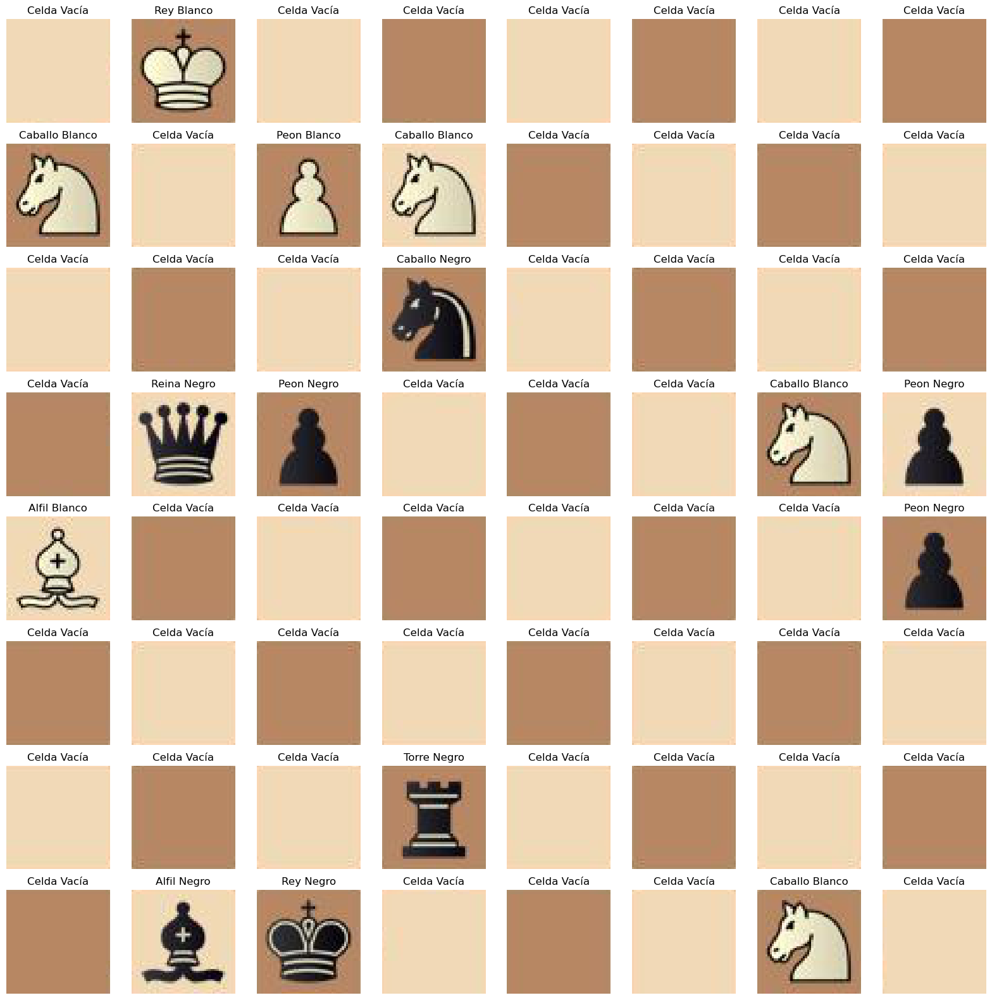

In [105]:
#Primero cargamos el tablero 5
image_path = os.path.join(path_tableros, "1K6-N1PN4-3n4-1qp3Np-B6p-8-3r4-1bk3N1.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color2(window))
        axs[row, col].axis('off')
print(FEN(image))

Podemos comprobar que ahora funciona correctamente.

#### TABLERO 2

B7/6b1/R3k2P/8/7q/6P1/5K2/6B1/


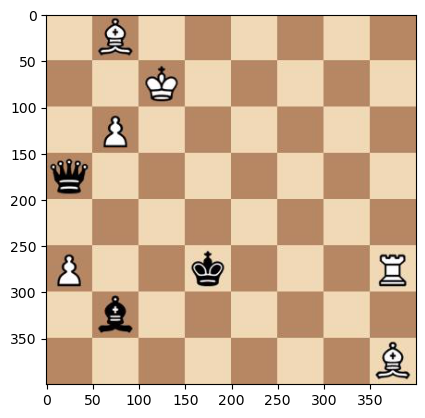

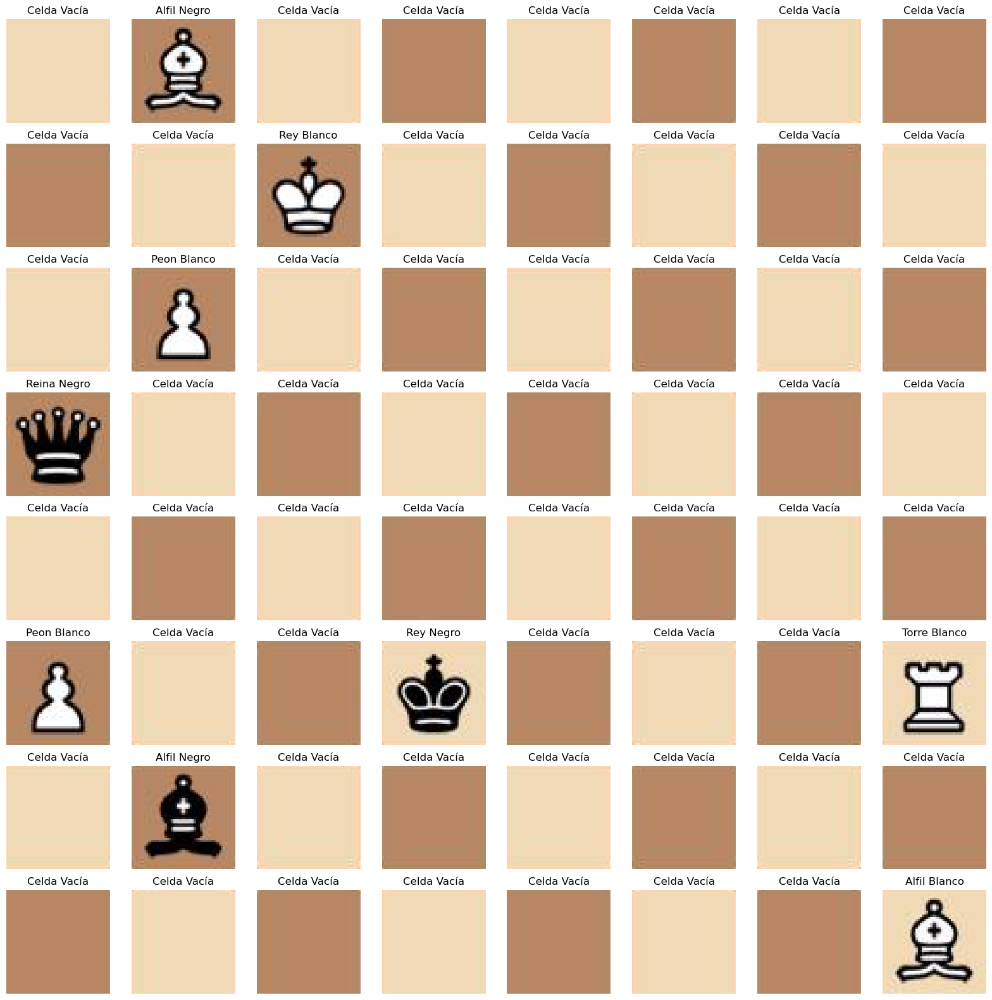

In [97]:
#Primero cargamos el tablero 2
image_path = os.path.join(path_tableros, "1B6-2K5-1P6-q7-8-P2k3R-1b6-7B.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color2(window))
        axs[row, col].axis('off')
print(FEN(image))

Nuevamente encontramos un error ya que el primer alfil lo detecta como negro cuando es claramente blanco. Vamos a ver que ha pasado:

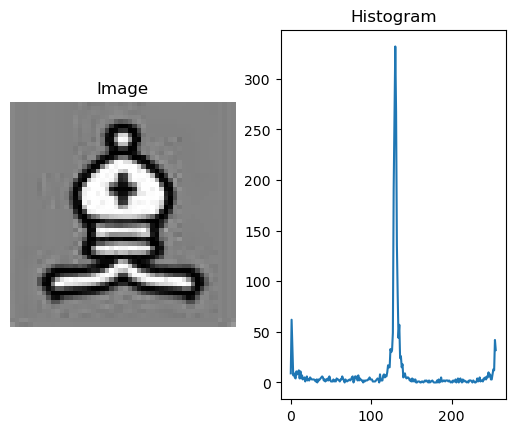

In [81]:
imagen=windows[1]
#dibujar el histograma de color de la imagen y al lado  la imagen
image_byn = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
image_bw= np.dstack([image_byn, image_byn, image_byn])
hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
# Plot the image
plt.subplot(1, 2, 1)
plt.imshow(image_bw)
plt.title('Image')
plt.axis('off')
# Plot the histogram
plt.subplot(1, 2, 2)
plt.plot(hist)
plt.title('Histogram')
plt.show()

Podemos observar que ocurre un fenomeno extraño que nunca nos habia pasado antes pues en el histograma se puede ver que el valor maximo en la zona negra es bastante superior al de la zona blanca

Creamos una nueva función color:

Nos hemos dado cuenta que todas los histogramas de fichas negras tienen un valor en el 0 mayor a 50, aprovechando esto creamos la nueva función:

In [89]:
def color3(pieza):
    image_byn = cv2.cvtColor(pieza, cv2.COLOR_BGR2GRAY)
    image_bw= np.dstack([image_byn, image_byn, image_byn])
    hist = cv2.calcHist([image_bw],[0],None,[256],[0,256])
    #sumar de hist[0] a hist[20]
    negro = hist[0]
    blanco = hist[255]
    if negro > 50:
        return "Negro"
    elif blanco != 0:
        return "Blanco"
    else:
        return "Tablero"

In [94]:
def FEN(image):
    windows = sliding_window(image, (50, 50), 50)
    FEN = ""
    contador=0
    #empezando por la ultima ventana, identifica la pieza 
    for i, window in enumerate(windows[::-1]):
        results = search2(window)
        if results == "Celda Vacía":
            if (i+1) % 8 == 0:
                FEN += str(contador+1)
                contador = 0
                FEN += "/"
            else:
                contador += 1
        else:
            if(contador != 0):
                FEN += str(contador)
                contador = 0
            if results == "Rey" and color3(window) == "Blanco":
                FEN += "K"
            elif results == "Rey" and color3(window) =="Negro":
                FEN+="k"
            elif results == "Reina" and color3(window) == "Blanco":
                FEN += "Q"
            elif results == "Reina" and color3(window) =="Negro":
                FEN+="q"
            elif results == "Torre" and color3(window) == "Blanco":
                FEN += "R"
            elif results == "Torre" and color3(window) =="Negro":
                FEN+="r"
            elif results == "Alfil" and color3(window) == "Blanco":
                FEN += "B"
            elif results == "Alfil" and color3(window) =="Negro":
                FEN+="b"
            elif results == "Peon" and color3(window) == "Blanco":
                FEN += "P"
            elif results == "Peon" and color3(window) =="Negro":
                FEN+="p"
            elif results == "Caballo" and color3(window) == "Blanco":
                FEN += "N"
            elif results == "Caballo" and color3(window) =="Negro":
                FEN+="n"
            if (i+1) % 8 == 0:
                if(results=="Celda Vacía"):
                    FEN += str(contador)
                    contador = 0
                FEN += "/"
           
    return(FEN)

B7/6b1/R3k2P/8/7q/6P1/5K2/6B1/


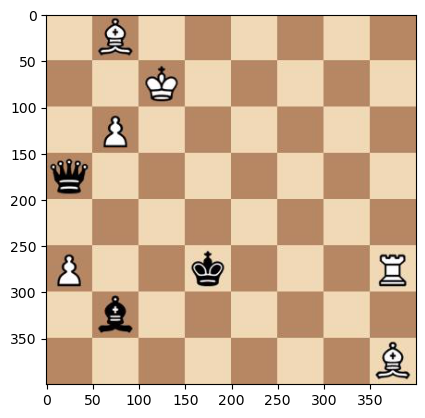

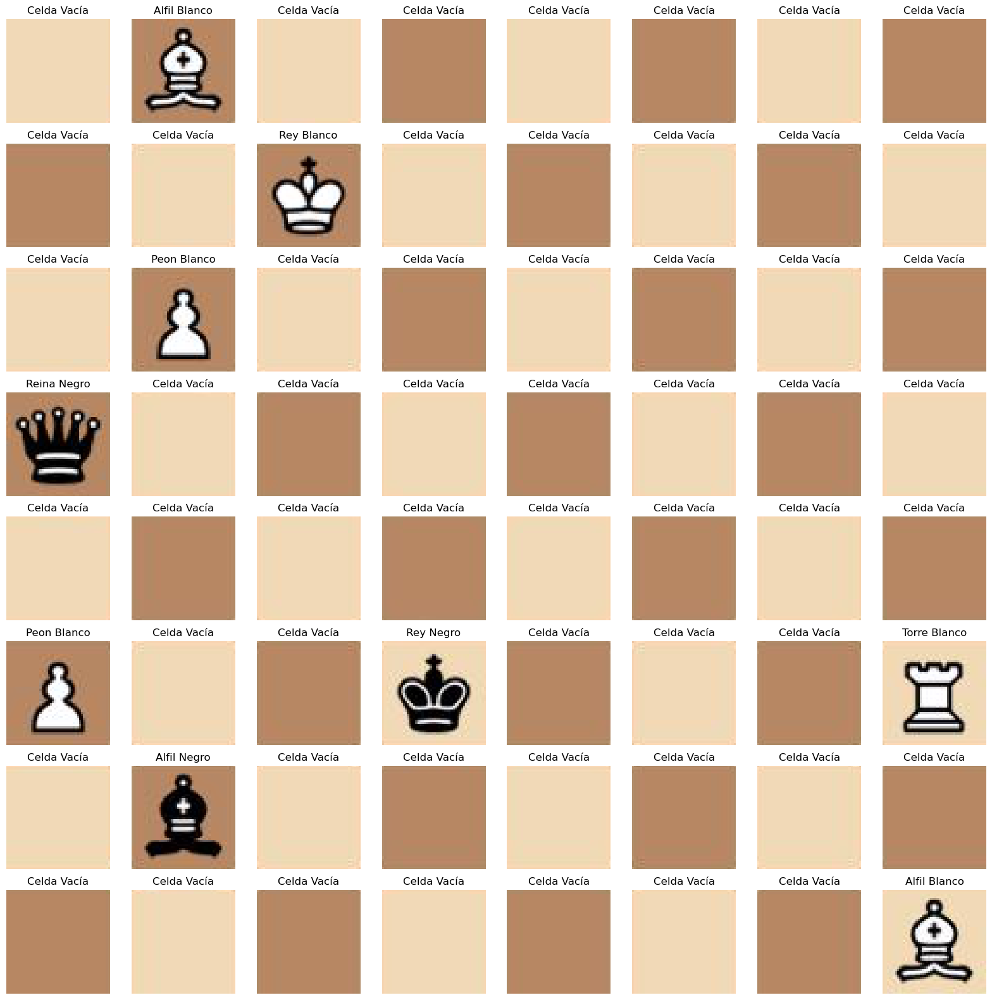

In [96]:
#Primero cargamos el tablero 2
image_path = os.path.join(path_tableros, "1B6-2K5-1P6-q7-8-P2k3R-1b6-7B.jpeg")
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#show the original image on rgb
plt.imshow(image)
windows = sliding_window(image, (50, 50), 50)
#transform the windows into images and draw them in a grid of 8 x 8
fig, axs = plt.subplots(8, 8, figsize=(20, 20))
for i, window in enumerate(windows):
    row = i // 8
    col = i % 8
    results = search2(window)
    
    axs[row, col].imshow(window)
    if results == "Celda Vacía":
        axs[row, col].set_title(results)
        axs[row, col].axis('off')
    else:
        axs[row, col].set_title(results+" "+color3(window))
        axs[row, col].axis('off')
print(FEN(image))

Ahora comprobamos que funciona correctamente

# 3 Extracción de características con Deep Learning y búsqueda de imágenes
Se va a comprobar ahora el poder de la inteligenciar artificial para la extracción de características en imagen. Para ello se pretende desarrollar a continuación el mismo motor de búsqueda que se creó en el primer apartado (para el dataset de las flores) pero ahora en lugar de emplear algoritmos destinados a la extracción de características en imagen, se van a extraer estos vectores mediante redes neuronales. Se va a realizar la comprobación mediante tres técnicas.

1. Empleo de una rede neuronal pre-entrenada en un dataset con gran cantidad de clases.
2. Finetuning de la red neuronal modificando parte de la red de cara a entrenar sólo unas capas de la red.
3. Entrenamiento completo de la red neuronal.

Con estos tres experimentos se van a comprobar varias cosas. El primero de ellos nos ayudará a comprender si una red pre-entrenada seleccionada, sin ser entrenada de nuevo en el dataset bajo estudio, es capaz de extraer características relevantes de las imágenes. Con el segundo, mantendremos una parte de la red sin reentrenar, y sólo se entrenará la parte final para realizar una clasificación. Esto nos servirá para comprobar si el reentranimento de unas pocas capas es suficiente para mejorar los resultados dado lo costodo d eentrenar la red completa. Finalmente entrenaremos la red completa de principio a fin para comprobar si los resultados mejoran notablemente en comparación con los anteriores. Realizados todos los experimentos se abre una sección final en la que se realizará una comparativa en detalle de los resultados obtenidos en el apartado 1 y los obtenidos con estos nuevos experimentos extrayendo las conclusiones más relevantes.

Para todo el desarrollo se va a emplear la red ResNet18 pre-entrenada en un dataset similar al empleado pero mucho más grande. Este dataset tiene el nombre de Oxford 102 Flowers Dataset y se puede encontrar toda la información relativa al mismo en el siguiente enlace:

- https://www.robots.ox.ac.uk/~vgg/data/flowers/102/

Como resumen general el dataset se compone de 102 clases distintas de flores (muchas más que en nuestro problema original con 17 clases). Este dataset se ha empleado previamente para gran cantidad de experimentos generales y pruebas por lo que ya existen modelos de inteligencia artificial mediante redes convolucionales para clasificación previamente entrenados en el. Específicamente, vamos a empelar para este desarrollo el modelo ResNet18 el cual podemos encontrar entrenado en diferentes fuentes con una precisión que alcanza el 93% en el conjunto de evaluación de este dataset.

Esta red se puede encontrar definida por defecto dentro de la librería pytorch concretamente en el paquete adicional torchvision el cual proporciona gran cantidad de las redes por defecto más empleadas en la literatura a modo de extractores de características.

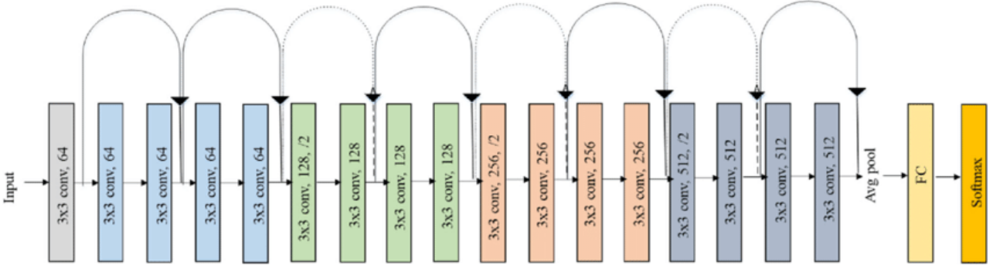

Como se observa en la figura anterior la red se compone de diversas capas convolucionales con la idea propuesta por ResNet de la residualidad. Finalmente se añade un average pooling y un clasificador mediante capas totalmente conectadas de neuronas. En el siguiente código se proporcionará directamente el código para utilizar esta red ya preentrenada y extraer los vectores de características que serán los que vamos a emplear para realizar la búsqueda.

In [120]:
# Imports here
import torch #conda install pytorch torchvision torchaudio cudatoolkit=11.1 -c pytorch
import numpy as np
import pandas as pd
from torchvision import datasets
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler
import torchvision.models as models
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.autograd import Variable
from PIL import Image
import os
import json
import matplotlib.pyplot as plt
from glob import glob
from tqdm import tqdm
import time
import copy

En este apartado se va a cargar el modelo ResNet18 de la librería torchvision y se va a reemplazar la parte del clasificador (capas de neuronas totalmente conectadas) que proporciona por defecto para que sea el mismo que la red que se proporciona entrenada.

In [121]:
main_datasets_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/'

In [122]:
# Function that loads a checkpoint and rebuilds the model
# Loading ResNet18 torchvision default implementation and modifying fully connected layers with the ones in the pretrained model
model = models.resnet18()
num_features = model.fc.in_features
model.fc = nn.Sequential(
                        nn.Linear(num_features, 512),
                          nn.ReLU(),
                          nn.BatchNorm1d(512),
                          nn.Dropout(0.4),
                          nn.Linear(512, 102), # Last layer has 102 neurons (102 classes in the dataset)
                          nn.LogSoftmax(dim=1))

# Loading pretrained model from provided file
model.load_state_dict(torch.load(main_datasets_path+"model_resnet18_102flowers.pt", map_location=torch.device('cpu'))["state_dict"])

# Model in evaluation mode
model.eval()

# Model in CPU or GPU if available
if torch.cuda.is_available():
    model = model.cuda()

In [123]:
# Function to preprocess the image to have the correct input format, input: path to the image
def process_image(image):
    ''' Scales, crops, and normalizes a PIL image for a PyTorch model,
        returns an Numpy array
    '''
    # images have to be normalized
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
    # preprocess step
    preprocess = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            normalize
        ])
    loaded_image = Image.open(image)
    img_tensor = preprocess(loaded_image).float()
    img_tensor = img_tensor.unsqueeze(0)
    np_image = np.array(img_tensor)
    return np_image

In [124]:
# Function to predict the topK labels with the trained model
def predict(image_path, model, topk=5):
    ''' Predict the class (or classes) of an image using a trained deep learning model.
    '''
    # preprocess image and added to GPU if available
    img_tensor = process_image(image_path)
    img_tensor = torch.from_numpy(img_tensor)
    if torch.cuda.is_available():
        img_tensor = img_tensor.cuda()
    # Pass the image to the network
    output = model(img_tensor)
    # softmax layer to convert the output to probabilities
    m = nn.Softmax()
    output = m(output)
    # Get probabilities from the output and convert to labels
    probabilities = torch.topk(output,5)[0]
    labels = torch.topk(output,5)[1]
    if torch.cuda.is_available():
        probabilities = probabilities.cpu()
        labels = labels.cpu()

    return probabilities.detach().numpy(), labels.detach().numpy()

Aquí se realiza la predicción para una imagen. La salida de la red neuronal nos proporciona las probabilidades y predicciones de las topK clases. Para conocer el nombre de la clase empleamos el fichero de conversión proporcionado en el dataset.

In [125]:
test_img_path = main_datasets_path+"Dataset_Flores/Bluebell/image_0241.jpg"
topk = 5
probs, preds = predict(test_img_path, model, topk)
print("Clases predichas y probabilidades:")
print(preds, probs)

path_labels_coding = main_datasets_path+"cat_to_name.json"
# Open the JSON file for reading
with open(path_labels_coding, "r") as json_file:
    # Parse the JSON data
    cat_to_name = json.load(json_file)

idx_to_name = {category: cat_to_name[str(category+1)] for category in preds[0]}
classes = list(idx_to_name.values())
print('This flower is most likely a {} with a {:.6f} probability!'.format(classes[0], probs[0][0]))
print('This flower could also possibly be:')
for i in range(len(probs[0])):
    if i != 0:
        print('{} with a {:.6f} probability'.format(classes[i], probs[0][i]))

Clases predichas y probabilidades:
[[23 20 77 85 79]] [[0.57505333 0.33299944 0.03745915 0.01644436 0.01241453]]
This flower is most likely a red ginger with a 0.575053 probability!
This flower could also possibly be:
fire lily with a 0.332999 probability
lotus lotus with a 0.037459 probability
tree mallow with a 0.016444 probability
anthurium with a 0.012415 probability


Necesitamos también que la red nos devuelva el vector de características que emplearemos para realizar la búsqueda. Para ello debemos acceder a la información que se predice en la red antes del clasificador.

In [126]:
# Function to predict the feature vector before the classifier in the network
def predict_feature_vector(image_path, model):
    ''' Predict the class (or classes) of an image using a trained deep learning model.
    '''
    # preprocess image and added to GPU if available. Delete fc layer
    model.fc = torch.nn.Identity()
    img_tensor = process_image(image_path)
    img_tensor = torch.from_numpy(img_tensor)
    if torch.cuda.is_available():
        img_tensor = img_tensor.cuda()
    # Pass the image to the network
    output = model(img_tensor)
    if torch.cuda.is_available():
        output = output.cpu()

    return output.detach().numpy()

In [127]:
test_img_path = main_datasets_path+"Dataset_Flores/Bluebell/image_0241.jpg"
feature_vector = predict_feature_vector(test_img_path, model)
print(feature_vector.shape)

(1, 512)


## Creación de la base de datos de vectores de características extraídos con la red neuronal
Para realizar la búsqueda se va a crear una base de datos que almacene todos los vectores de características de todas las imágenes. Lo que interesa ahora es extraer de cada imagen el vector de características de cada una de las imágenes en el deataset tras pasar por la red neuronal. Para ello, uitlice las funciones que previamente se presentan dónde debe introducir la ruta a la imagen y el código proporciona el vector de cactarísticas de tamaño (1, 512).

In [128]:
db={}
species_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores/'
species = os.listdir(species_path)

for specie in species:
    ruta=species_path+specie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]
    for image_name in image_files:
      db[image_name]={}
      # Load the image
      image_path = os.path.join(ruta, image_name)
      db[image_name]= predict_feature_vector(image_path, model)

Comprobamos que tiene las dimensiones correctas

In [137]:
#comprobar las dimensiones de la base de datos
print(len(db))
print(len(db["image_0241.jpg"][0]))

1344
512


## Análisis en reducción de dimensionalidad (PCA, T-SNE, Otros métodos)
De cara a explorar más en detalle los vectores extraídos, puede emplear técnicas de reducción de dimensionalidad, clustering, entre otras para visualizar los resultados en gráficos y ver si existen diferencias notables en los vectores de características.

### PCA

In [141]:
from sklearn.cluster import KMeans
n_clusters = 17
kmeans = KMeans(n_clusters=n_clusters)

Primero vamos a crear un vector con todos los vectores de características de las imágenes. Para ello, se va a recorrer el dataset y se va a extraer el vector de características de cada imagen.

In [142]:
vectores = []
for key in db.keys():
    vectores.append(db[key][0])
    

c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


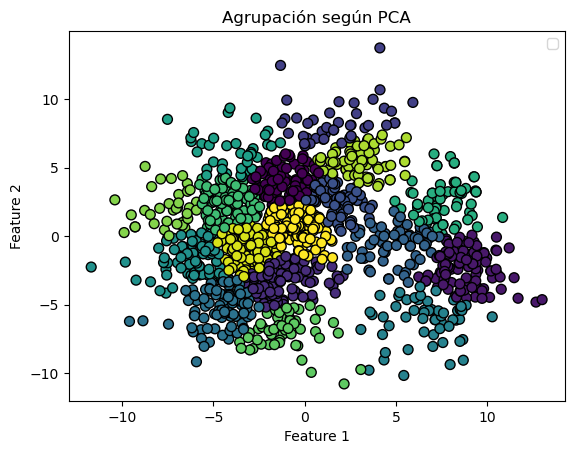

In [143]:
from sklearn.decomposition import PCA
componentes = 2 #fijamos el nuemro de componentes al que queremos reducir la dimensionalidad 
pca=PCA(n_components=componentes)
PCA=pca.fit_transform(vectores)

KMEANS = kmeans.fit_predict(PCA)
plt.scatter(PCA[:, 0], PCA[:, 1], c=KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según PCA')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()
plt.show()


### TSNE

In [144]:
from sklearn.manifold import TSNE
componentes = 2 #fijamos el nuemro de componentes al que queremos reducir la dimensionalidad
tsne=TSNE(n_components=componentes)

c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


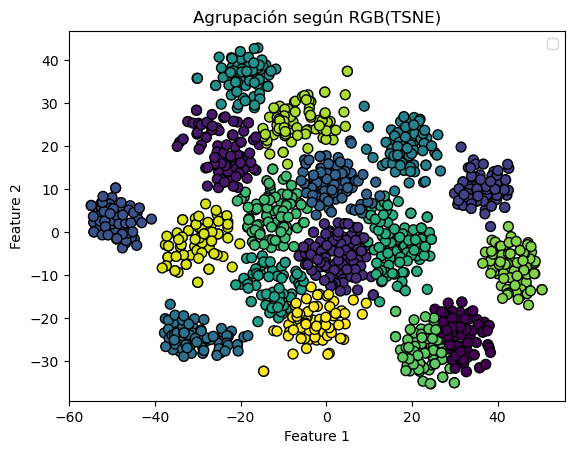

In [147]:
TSNE=tsne.fit_transform(np.array(vectores))
KMEANS = kmeans.fit_predict(TSNE)
plt.scatter(TSNE[:, 0], TSNE[:, 1], c=KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según RGB(TSNE)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()

La conclusión que podemos sacar tras visualizar estos 2 gráficos es que con TSNE si que se muestran unos clusters bien diferenciados, mientras que con PCA no se ve tan claramente.

## Desarrollo de la solución de búsqueda
Ahora debe desarrollar la solución que permita la búsqueda en la base de datos mediante una imágen "query" que se comparará con todas las de la base de datos. Para ello debe realizar la comparación del vector de características que desee emplear de la imagen query con el vector de características del mismo tipo de todas las imágenes de la base de datos. Para esta parte puede reutilizar el código que ya haya desarrollado previamente en tareas anteriores y emplear la métrica de distancia que considere oportuna.

Hacemos una funcion muy parecida a la del apartado 1:

In [154]:
def search(image, db, n_results=10):
    results = {}
    for key in db.keys():
        features=predict_feature_vector(image, model)
        d = np.linalg.norm(db[key][0]-features)
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    return list(results.keys())[:n_results]

## Análisis de resultados de búsqueda
Realice varias búsquedas para probar su solución con las imágenes "query" que se proprocionan en la carpeta adicional. Comente los resultados obtenidos en detalle, si cumplen las espectativas y que sucede con cada vector de características.

Copiamos la funcion para mostrar los resultados:

In [162]:
def show_results(query, results, species, species_path):
    #imprime la imagen de query y las 10 imagenes del resulado
    
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 11, 1)
    plt.axis('off')
    plt.imshow(cv2.cvtColor(query, cv2.COLOR_BGR2RGB))
    plt.title('Query')
    #para buscar las imagenes de los resultados se tienen que recorrer todas las especies y ver si el nombre del resultado coincide con alguno de los nombres de las imagenes de esa especie
    for i, result in enumerate(results):
        for specie in species:
            ruta=species_path+specie
            image_files = [file for file in os.listdir(ruta)]
            if result in image_files:
                image_path = os.path.join(ruta, result)
                image = cv2.imread(image_path)
                plt.subplot(1, 11, i+2)
                plt.axis('off')
                plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
                plt.title(specie)
                break


['image_0272.jpg', 'image_0082.jpg', 'image_1353.jpg', 'image_0300.jpg', 'image_0583.jpg', 'image_0107.jpg', 'image_0266.jpg', 'image_0113.jpg', 'image_0269.jpg', 'image_1119.jpg']


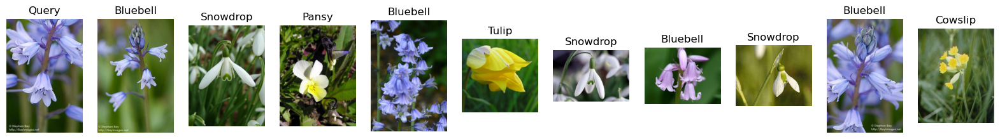

In [163]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 1
especie="Bluebell"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0795.jpg', 'image_0736.jpg', 'image_0729.jpg', 'image_0734.jpg', 'image_0798.jpg', 'image_0723.jpg', 'image_0721.jpg', 'image_0787.jpg', 'image_0751.jpg', 'image_0735.jpg']


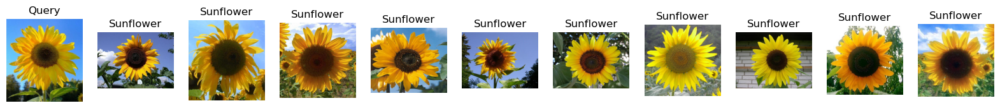

In [164]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 2
especie="Sunflower"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0569.jpg', 'image_0024.jpg', 'image_0072.jpg', 'image_0595.jpg', 'image_1224.jpg', 'image_0567.jpg', 'image_0016.jpg', 'image_0058.jpg', 'image_0562.jpg', 'image_0571.jpg']


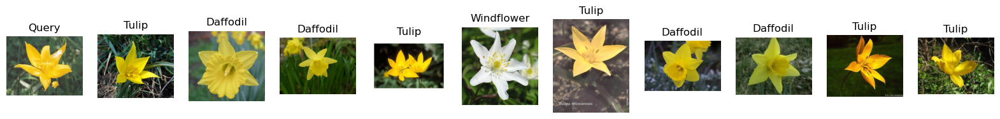

In [165]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 3
especie="Tulip"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0093.jpg', 'image_0095.jpg', 'image_0082.jpg', 'image_0113.jpg', 'image_0317.jpg', 'image_1301.jpg', 'image_0228.jpg', 'image_0099.jpg', 'image_1318.jpg', 'image_0101.jpg']


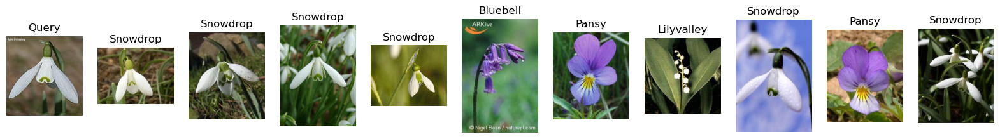

In [166]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 3
especie="Snowdrop"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

Viendo estos resultados podemos ver que son bastante acertados, ya que, siempre detecta la flor mas similar de la flor correcta(al menos de las especies que hemos probado) y que son mucho mejores a los de los metodos del apartado 1, además el tiempo de ejecucción es considerablemente menor.

## Finetuning y reentrenamiento del modelo completo
Dado que la red neuronal preentrenada no es específica del dataset empleado en esta tarea, aunque es posible que contenga a alguna o varias de las clases puesto que está compuesto por 102 en total, podrían mejorarse los resultados reentrenando la red neuronal con el dataset bajo estudio. Dado que esto es una tarea costosa se propone dos alternativas para esta parte. Por un lado se proporciona el código para realizar el entrenamiento y evaluación de la red neuronal. Se proponen dos modalidades:

- Entrenamiento de parte de las capas (última convolución + clasificador), finetuning.
- Entrenamiento completo de la red.

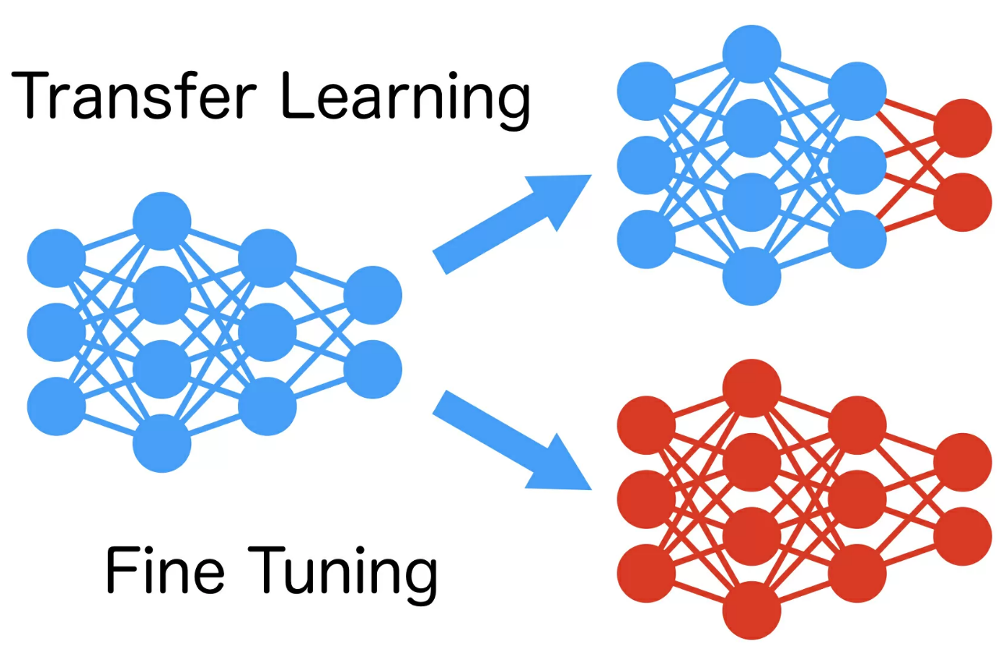

Para este apartado, seleccione una de las dos soluciones, entrene la red neuronal y utilice la red entrenada para crear de nuevo la base de datos de vectores de búsqueda. A continuación se proporciona el código para ambas soluciones de cara a seleccionar parte de las capas para que no se entrenen o para entrenar el modelo completo. Así mismo se proveé el código para entrenar y evaluar los resultados.

## Pytorch dataloder para el dataset de las flores proporcionado

In [168]:
# Pytorch dataloader for Flower dataset
# Define transforms for the training and validation sets
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
data_transforms = transforms.Compose([
        transforms.RandomResizedCrop(size=256, scale=(0.8, 1.0)),
        transforms.RandomRotation(degrees=15),
        transforms.ColorJitter(),
        transforms.RandomHorizontalFlip(),
        transforms.CenterCrop(size=224),
        transforms.ToTensor(),
        normalize,
    ])

# Crear un dataset utilizando ImageFolder
dataset_dir = "./content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores"
dataset = datasets.ImageFolder(dataset_dir, transform=data_transforms)

# Tamaños para los conjuntos de train y validation
porcentaje_validation = 0.2
tamaño_validation = int(len(dataset) * porcentaje_validation)
tamaño_train = len(dataset) - tamaño_validation

# Dividir el dataset en train y validation
train_dataset, validation_dataset = random_split(dataset, [tamaño_train, tamaño_validation])

In [169]:
# Define batch size
batch_size = 32
# Using the image datasets and the trainforms, define the dataloaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
validate_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size, shuffle=False)

data_loader = {}
data_loader['train'] = train_loader
data_loader['valid'] = validate_loader

In [170]:
# Testing dataloader sizes
for images, labels in data_loader["train"]:
    print("Batch images size: ", images.size())
    print("Labels batch size: ", labels.size())
    break

Batch images size:  torch.Size([32, 3, 224, 224])
Labels batch size:  torch.Size([32])


## Bucle de entrenamiento y validación

In [171]:
def train_model(model, criterion, optimizer, scheduler, gpu_mode, data_loader, n_epochs=10):
    # keeping track of best weights
    best_model_wts = copy.deepcopy(model.state_dict())
    valid_loss_min = np.Inf # track change in validation loss

    for epoch in range(1, n_epochs+1):
        # keep track of duration of each epoch
        since = time.time()
        running_losses  = {}
        running_accuracies  = {}
        for phase in ['train', 'valid']:
            # keep track of training and validation loss and accuracy
            running_loss = 0.0
            running_acc = 0.0
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            for data, target in data_loader[phase]:
                # move tensors to GPU if CUDA is available
                if gpu_mode:
                    data, target = data.cuda(), target.cuda()

                # clear the gradients of all optimized variables
                optimizer.zero_grad()

                # forward pass: compute predicted outputs by passing inputs to the model
                output = model(data)
                # calculate the batch loss
                loss = criterion(output, target)

                # backward + optimize only if in training phase
                if phase == 'train':
                    # backward pass: compute gradient of the loss with respect to model parameters
                    loss.backward()
                    # perform a single optimization step (parameter update)
                    optimizer.step()

                # get prediction and accuracy in train and validation phase, convert output probabilities to predicted class
                _, preds = torch.max(output, 1)
                running_acc += torch.sum(preds == target.data)
                # update average running loss
                running_loss += loss.item()*data.size(0)

            # calculate average losses
            running_losses[phase] = running_loss/len(data_loader[phase].dataset)
            running_accuracies[phase] = running_acc
            if phase == 'valid':
                # reduce learning rate only when the validation loss doesnt decrease for a bit.
                scheduler.step(running_losses[phase])

        train_accuracy = float(running_accuracies["train"])/float(len(data_loader['train'].dataset))
        valid_accuracy = float(running_accuracies["valid"])/float(len(data_loader['valid'].dataset))

        # print training/validation statistics
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f} \tTraining Accuracy: {:.6f} ({}/{}) \tValidation Accuracy: {:.6f} ({}/{})'.format(
            epoch, running_losses['train'], running_losses['valid'], train_accuracy, int(running_accuracies["train"]), len(data_loader['train'].dataset), valid_accuracy, int(running_accuracies["valid"]), len(data_loader['valid'].dataset)))

        # save model if validation loss has decreased
        if running_losses['valid'] <= valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
            valid_loss_min, running_losses['valid']))
            best_model_wts = copy.deepcopy(model.state_dict())
            valid_loss_min = running_losses['valid']

        elapsed_time = time.time() - since
        print()
        print("Epoch completed in {:.0f}m {:.0f}s".format(elapsed_time // 60, elapsed_time % 60))
        torch.cuda.empty_cache()

    model.load_state_dict(best_model_wts)
    return model

## Función para almacenar en disco el modelo entrenado

In [172]:
# Save the checkpoint
def save_checkpoint(model, optimizer, scheduler, model_file):
    parameters = {
        'classifier': model.fc,
        'state_dict': model.state_dict(),
        'optimizer': optimizer,
        'optimizer_state_dict': optimizer.state_dict(),
        'scheduler': scheduler,
        'scheduler_state_dict': scheduler.state_dict()
    }
    torch.save(parameters, model_file)

## Creación del modelo para Finetuning empleando los pesos preentrenados

In [173]:
# Function that loads a checkpoint and rebuilds the model
# Loading ResNet18 torchvision default implementation and modifying fully connected layers with the ones in the pretrained model
model = models.resnet18()
num_features = model.fc.in_features
model.fc = nn.Sequential(
                        nn.Linear(num_features, 512),
                          nn.ReLU(),
                          nn.BatchNorm1d(512),
                          nn.Dropout(0.4),
                          nn.Linear(512, 102), # Last layer has 102 neurons (102 classes in the dataset)
                          nn.LogSoftmax(dim=1))

# Loading pretrained model from provided file
model.load_state_dict(torch.load(main_datasets_path+"model_resnet18_102flowers.pt", map_location=torch.device('cpu'))["state_dict"])

# Changing fully connected part for the new dataset
model.fc = nn.Sequential(
                        nn.Linear(num_features, 512),
                          nn.ReLU(),
                          nn.BatchNorm1d(512),
                          nn.Dropout(0.4),
                          nn.Linear(512, 17), # Last layer has 17 neurons (17 classes in the dataset)
                          nn.LogSoftmax(dim=1))

# For finetuning only the last convolutional layer and fully connected layers uncomment the following part
# Congelar todas las capas
'''for param in model.parameters():
    param.requires_grad = False
# Descongelar las capas de la última convolución y las totalmente conectadas (Descongelar la última capa convolucional (layer4))
for param in model.layer4.parameters():
    param.requires_grad = True
# Descongelar la capa totalmente conectada
for param in model.fc.parameters():
    param.requires_grad = True
# Verificar qué capas están congeladas y cuáles no (opcional)
for name, param in model.named_parameters():
    print(f"{name} is {'not ' if param.requires_grad else ''}frozen")'''

# Model in CPU or GPU if available
if torch.cuda.is_available():
    model = model.cuda()

## Parámetros y definiciones necesarias para el entrenamiento

In [174]:
# Define the loss function and optimizer
learning_rate = 0.001  # Learning rate
training_epochs = 30   # Number of epochs
gpu_mode = torch.cuda.is_available()  # Check if GPU available
model_name = "model_resnet18_flowers_finetuning"  # Name of the model to store in disck
criterion = nn.NLLLoss()  # Loss Function for the network training
optimizer = optim.Adam(model.parameters(),lr=learning_rate)  # Optimizer for training
m_lr_scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, 'min',patience=3,verbose=True)  # Scheduler to modify the learning rate during training

c:\Users\dcobo\anaconda3\Lib\site-packages\torch\optim\lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


## Entrenamiento del modelo, evaluación y almacenamiento

In [175]:
print('Training and evaluating model, this will take some time to complete!!!')
model = train_model(model, criterion, optimizer, m_lr_scheduler, gpu_mode, data_loader, n_epochs=training_epochs)
print('Saving best model...')
save_checkpoint(model, optimizer, m_lr_scheduler, model_name + '.pt')

Training and evaluating model, this will take some time to complete!!!


Epoch: 1 	Training Loss: 0.980217 	Validation Loss: 1.446129 	Training Accuracy: 0.736059 (792/1076) 	Validation Accuracy: 0.690299 (185/268)
Validation loss decreased (inf --> 1.446129).  Saving model ...

Epoch completed in 0m 42s
Epoch: 2 	Training Loss: 0.390794 	Validation Loss: 1.133335 	Training Accuracy: 0.889405 (957/1076) 	Validation Accuracy: 0.716418 (192/268)
Validation loss decreased (1.446129 --> 1.133335).  Saving model ...

Epoch completed in 0m 42s
Epoch: 3 	Training Loss: 0.334647 	Validation Loss: 0.752664 	Training Accuracy: 0.902416 (971/1076) 	Validation Accuracy: 0.798507 (214/268)
Validation loss decreased (1.133335 --> 0.752664).  Saving model ...

Epoch completed in 0m 43s
Epoch: 4 	Training Loss: 0.311280 	Validation Loss: 0.468183 	Training Accuracy: 0.905204 (974/1076) 	Validation Accuracy: 0.843284 (226/268)
Validation loss decreased (0.752664 --> 0.468183).  Saving model ...

Epoch completed in 0m 42s
Epoch: 5 	Training Loss: 0.212432 	Validation Loss: 0

## Creación de la base de datos de vectores de características con el nuevo modelo
Ahora que ha entrenado su nuevo modelo con el dataset proporcionado y aplicando el finetuning al modelo anterior entrenado en el otro dataset se quiere volver a realizar la búsqueda para comparar resultados. Para ello, extraíga los vectores de características con este nuevo modelo entrenado y almacenelos.

Utilisamos el mismo codigo que en el modelo anterior:

In [176]:
db={}
species_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Dataset_Flores/'
species = os.listdir(species_path)

for specie in species:
    ruta=species_path+specie
    # Get a list of image files for the current species
    image_files = [file for file in os.listdir(ruta)]
    for image_name in image_files:
      db[image_name]={}
      # Load the image
      image_path = os.path.join(ruta, image_name)
      db[image_name]= predict_feature_vector(image_path, model)

In [177]:
#comprobar las dimensiones de la base de datos
print(len(db))
print(len(db["image_0241.jpg"][0]))

1344
512


## Analisis en reducción dimensional (PCA, T-SNE, Otros...)
Analice los resultados gráficamente mediante la aplicación de técnicas de reducción dimensional, clustering, entre otras de cara a comprobar si los vectores generados son separables en el espacio y comente en detalle todo lo que observe.

### PCA

c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


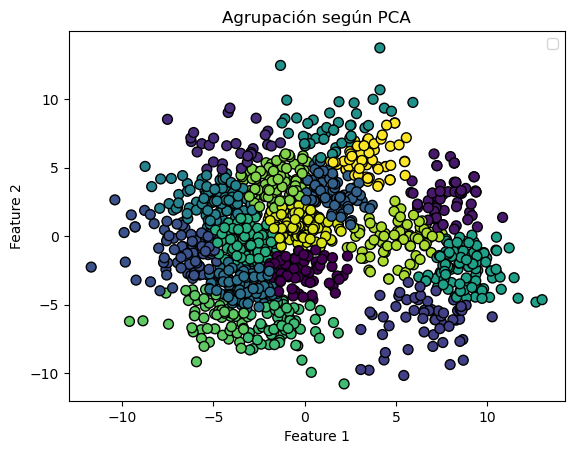

In [178]:
from sklearn.decomposition import PCA
componentes = 2 #fijamos el nuemro de componentes al que queremos reducir la dimensionalidad 
pca=PCA(n_components=componentes)
PCA=pca.fit_transform(vectores)

KMEANS = kmeans.fit_predict(PCA)
plt.scatter(PCA[:, 0], PCA[:, 1], c=KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según PCA')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()
plt.show()


### TSNE

c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\dcobo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


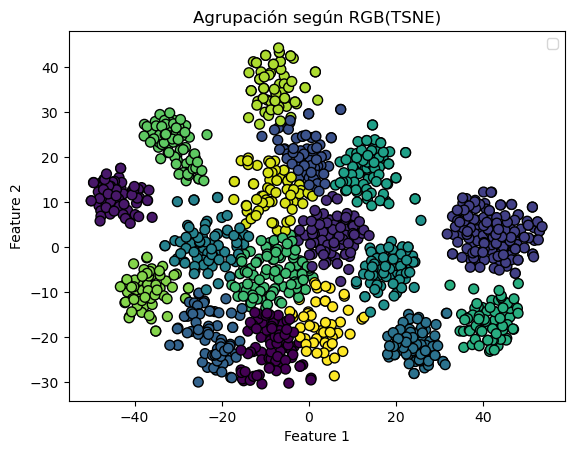

In [179]:
TSNE=tsne.fit_transform(np.array(vectores))
KMEANS = kmeans.fit_predict(TSNE)
plt.scatter(TSNE[:, 0], TSNE[:, 1], c=KMEANS, cmap='viridis', edgecolor='k', s=50)
plt.title('Agrupación según RGB(TSNE)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()

A simple vista el analisis de reduccion de dimensionalidad tiene muy buena pinta y parece que los vectores generados son separables en el espacio.

## Búsqueda de imágenes similares
Realice de nuevo la búsqueda de imágenes para comprobar los resultados que se ofrecen. Analice si con estos nuevos vectores se mejoran los resultados anteriores, empeoran, son similares, y detalle todo lo que observe. Compare estos resultados con los obtenidos en el apartado anterior previo al finetuning.

In [180]:
def search(image, db, n_results=10):
    results = {}
    for key in db.keys():
        features=predict_feature_vector(image, model)
        d = np.linalg.norm(db[key][0]-features)
        results[key] = d
    results = {k: v for k, v in sorted(results.items(), key=lambda item: item[1])}
    return list(results.keys())[:n_results]

['image_0291.jpg', 'image_0270.jpg', 'image_0263.jpg', 'image_0260.jpg', 'image_0252.jpg', 'image_0264.jpg', 'image_0269.jpg', 'image_0259.jpg', 'image_0288.jpg', 'image_0277.jpg']


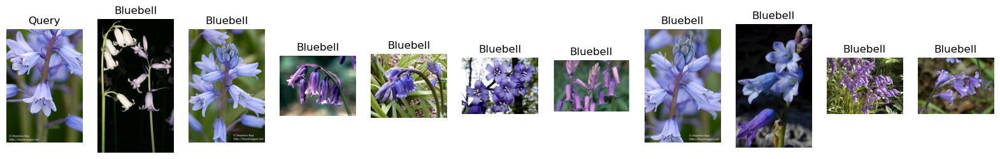

In [181]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 1
especie="Bluebell"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0756.jpg', 'image_0777.jpg', 'image_0736.jpg', 'image_0795.jpg', 'image_0798.jpg', 'image_0741.jpg', 'image_0758.jpg', 'image_0734.jpg', 'image_0767.jpg', 'image_0745.jpg']


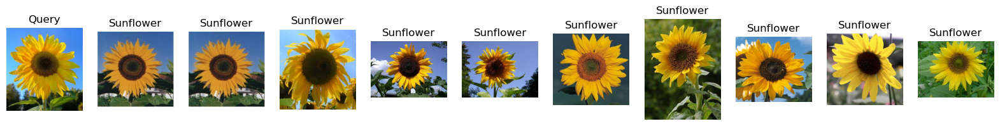

In [182]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 2
especie="Sunflower"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_1057.jpg', 'image_1058.jpg', 'image_1108.jpg', 'image_1094.jpg', 'image_1099.jpg', 'image_1054.jpg', 'image_1101.jpg', 'image_1082.jpg', 'image_1120.jpg', 'image_1081.jpg']


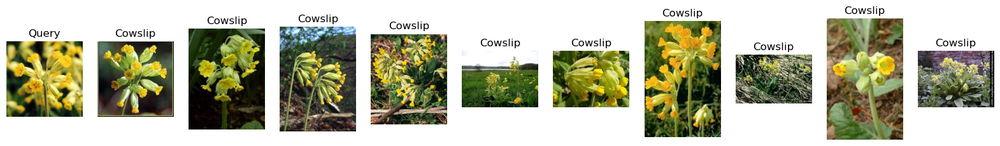

In [183]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 3
especie="Cowslip"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0325.jpg', 'image_0346.jpg', 'image_0337.jpg', 'image_0352.jpg', 'image_0338.jpg', 'image_0344.jpg', 'image_0354.jpg', 'image_0339.jpg', 'image_0335.jpg', 'image_0336.jpg']


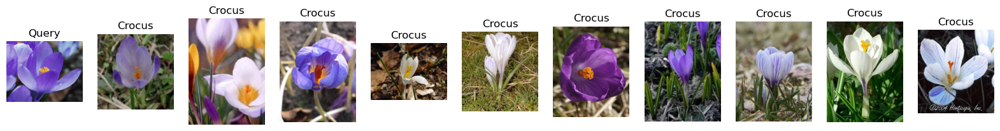

In [184]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 4
especie="Crocus"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0521.jpg', 'image_0524.jpg', 'image_0508.jpg', 'image_0494.jpg', 'image_0518.jpg', 'image_0491.jpg', 'image_0484.jpg', 'image_0498.jpg', 'image_0522.jpg', 'image_0516.jpg']


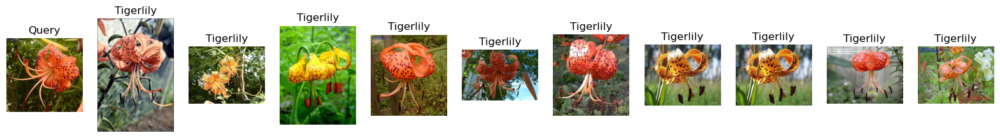

In [185]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 5
especie="Tigerlily"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_0682.jpg', 'image_0648.jpg', 'image_0674.jpg', 'image_0678.jpg', 'image_0675.jpg', 'image_0642.jpg', 'image_0703.jpg', 'image_0698.jpg', 'image_0668.jpg', 'image_0673.jpg']


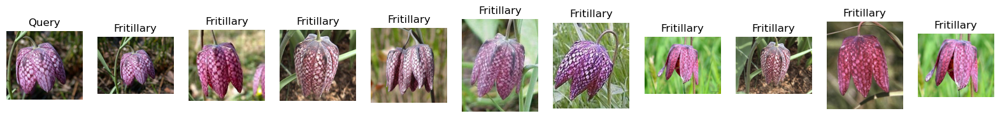

In [186]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 6
especie="Fritillary"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_1329.jpg', 'image_1288.jpg', 'image_1354.jpg', 'image_1312.jpg', 'image_1307.jpg', 'image_1317.jpg', 'image_1316.jpg', 'image_1310.jpg', 'image_1308.jpg', 'image_1291.jpg']


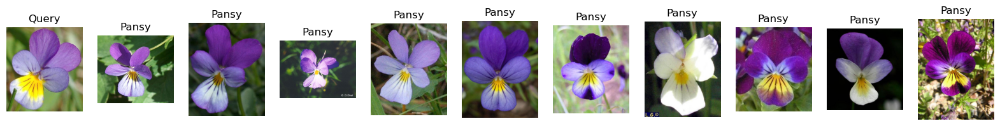

In [187]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 7
especie="Pansy"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

['image_1209.jpg', 'image_1233.jpg', 'image_1205.jpg', 'image_1218.jpg', 'image_1226.jpg', 'image_1248.jpg', 'image_1242.jpg', 'image_1207.jpg', 'image_1235.jpg', 'image_1251.jpg']


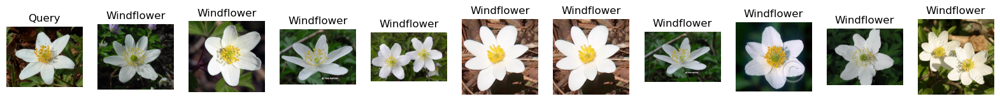

In [188]:
#Cargamos las imagenes de query
query_path = './content/drive/MyDrive/AVD/Trabajos_1_2/Datasets/Flores_Query/'

# QUERY 8
especie="Windflower"
ruta=query_path+especie

#coge la primera imagen de esa especie
image_files = [file for file in os.listdir(ruta)]
image_path = os.path.join(ruta, image_files[0])
query = cv2.imread(image_path)
#realiza la busqueda
results = search(image_path, db, n_results=10)
print(results)
show_results(query, results, species, species_path)

Tras haber anaizado la busqueda con 8 especies podemos concluir que este es el mejor metodo sin duda ya que ha sido capaz de realizar la busqueda a la perfección en todas las especies. Consigue arreglar los pocos errores que han ocurrido en el apartado anterior y el tiempo de ejecucion es muy similar.

Por lo tanto concluimos que con finetuning se obtienen los mejores resultados, siendo perfectos en las 8 especies que hemos probado.